In [1]:
import sys
import matplotlib.animation
print matplotlib.animation.writers.list()
print sys.path

sys.path.insert(0,'/home/antolikjan/projects/mozaik/contrib')
#sys.path.insert(0,'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/neo')
#sys.path.insert(0,'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik')
#sys.path.insert(0,'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/contrib')
import lsv1m_paper
import mozaik
from mozaik.controller import run_workflow, setup_logging
from mozaik.storage.datastore import Hdf5DataStore,PickledDataStore
from parameters import ParameterSet
from mozaik.visualization.plotting import *

from mozaik.analysis.technical import NeuronAnnotationsToPerNeuronValues
from mozaik.tools.mozaik_parametrized import colapse, colapse_to_dictionary, MozaikParametrized
from mozaik.analysis.analysis import *
from mozaik.analysis.vision import *
from mozaik.storage.queries import *
from mozaik.visualization.helper_functions import *

import sys
#sys.path.append('/home/jan/cluster_UNIC/mozaik/contrib/')
#sys.path.append('/home/jan/cluster_UNIC/mozaik/contrib/PushPullCCLISSOMModelSSIzL23')
#from analysis_and_visualization import perform_analysis_and_visualization
%matplotlib inline

setup_logging()

#data_store = PickledDataStore(load=True,parameters=ParameterSet({'root_directory':'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/contrib/New/20180416-011035[param_small_norand.defaults]CombinationParamSearch{12}/SelfSustainedPushPull_ParameterSearch_____sigma:1.4_sigma:1.4_base_weight:0.0012_num_samples:100_size:0.17_base_weight:0.001_base_weight:0.0009_inhibitory_connection_ratio:0.8_e_rev_I:-80_tau_syn_I:2.5_base_weight:0.0015_stdev:2.4','store_stimuli': False}),replace=True)

#data_store = PickledDataStore(load=True,parameters=ParameterSet({'root_directory':'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/contrib/New/20180605-104711[new_std_orf_large.defaults]CombinationParamSearch{13}/SelfSustainedPushPull_ParameterSearch_____sigma:3.0_base_weight:0.0012_base_weight:0.0007_tau_rec:50_sigma:1.2_base_weight:0.0013_sigma:2.0_layer23_aff_ratio:0.2_tau_syn_E:7.0_tau_syn_I:13.0_v_thresh:-54_base_weight:0.0027_stdev:2.2','store_stimuli': False}),replace=True)


data_store = PickledDataStore(load=True,parameters=ParameterSet({'root_directory':'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/contrib/New/20180716-133845[new_std_orf_large.defaults]CombinationParamSearch{13}/SelfSustainedPushPull_ParameterSearch_____sigma:1.2_base_weight:0.0014_size:0.17_K:1000_base_weight:0.0012_sigma:2.0_layer23_aff_ratio:0.25_tau_m:15.0_tau_syn_I:12.0_v_thresh:-54_density:2000_base_weight:0.0027_stdev:2.2','store_stimuli': False}),replace=True)




NeuronAnnotationsToPerNeuronValues(data_store,ParameterSet({})).analyse()
analog_ids = param_filter_query(data_store,sheet_name="V1_Exc_L4").get_segments()[0].get_stored_esyn_ids()
analog_ids_inh = param_filter_query(data_store,sheet_name="V1_Inh_L4").get_segments()[0].get_stored_esyn_ids()
analog_ids23 = param_filter_query(data_store,sheet_name="V1_Exc_L2/3").get_segments()[0].get_stored_esyn_ids()
analog_ids_inh23 = param_filter_query(data_store,sheet_name="V1_Inh_L2/3").get_segments()[0].get_stored_esyn_ids()

#find neuron with preference closet to 0  
l4_exc_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Exc_L4')[0]
l4_exc_phase = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentPhase', sheet_name = 'V1_Exc_L4')[0]
l4_exc = analog_ids[numpy.argmin([circular_dist(o,numpy.pi/2,numpy.pi)  for (o,p) in zip(l4_exc_or.get_value_by_id(analog_ids),l4_exc_phase.get_value_by_id(analog_ids))])]
l4_inh_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Inh_L4')[0]
l4_inh_phase = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentPhase', sheet_name = 'V1_Inh_L4')[0]
l4_inh = analog_ids_inh[numpy.argmin([circular_dist(o,numpy.pi/2,numpy.pi)  for (o,p) in zip(l4_inh_or.get_value_by_id(analog_ids_inh),l4_inh_phase.get_value_by_id(analog_ids_inh))])]
l4_exc_or_many = numpy.array(l4_exc_or.ids)[numpy.nonzero(numpy.array([circular_dist(o,numpy.pi/2,numpy.pi)  for (o,p) in zip(l4_exc_or.values,l4_exc_phase.values)]) < 0.1)[0]]

['ffmpeg', 'ffmpeg_file']
['', '/home/antolikjan/virt_env/oldmozaik/lib/python2.7', '/home/antolikjan/virt_env/oldmozaik/lib/python2.7/plat-x86_64-linux-gnu', '/home/antolikjan/virt_env/oldmozaik/lib/python2.7/lib-tk', '/home/antolikjan/virt_env/oldmozaik/lib/python2.7/lib-old', '/home/antolikjan/virt_env/oldmozaik/lib/python2.7/lib-dynload', '/usr/lib/python2.7', '/usr/lib/python2.7/plat-x86_64-linux-gnu', '/usr/lib/python2.7/lib-tk', '/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages', '/home/antolikjan/virt_env/oldmozaik/lib/python2.7/site-packages', '/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/IPython/extensions', '/home/antolikjan/.ipython']


  Starting NeuronAnnotationsToPerNeuronValues analysis
  Starting NeuronAnnotationsToPerNeuronValues Analysis
NeuronAnnotationsToPerNeuronValues analysis took: 15.3487439156seconds


In [2]:
%matplotlib inline
analog_ids = param_filter_query(data_store,sheet_name="V1_Exc_L4").get_segments()[0].get_stored_esyn_ids()
analog_ids_inh = param_filter_query(data_store,sheet_name="V1_Inh_L4").get_segments()[0].get_stored_esyn_ids()
spike_ids = param_filter_query(data_store,sheet_name="V1_Exc_L4").get_segments()[0].get_stored_spike_train_ids()
spike_ids_inh = param_filter_query(data_store,sheet_name="V1_Inh_L4").get_segments()[0].get_stored_spike_train_ids()

analog_ids23 = param_filter_query(data_store,sheet_name="V1_Exc_L2/3").get_segments()[0].get_stored_esyn_ids()
analog_ids_inh23 = param_filter_query(data_store,sheet_name="V1_Inh_L2/3").get_segments()[0].get_stored_esyn_ids()
spike_ids23 = param_filter_query(data_store,sheet_name="V1_Exc_L2/3").get_segments()[0].get_stored_spike_train_ids()
spike_ids_inh23 = param_filter_query(data_store,sheet_name="V1_Inh_L2/3").get_segments()[0].get_stored_spike_train_ids()


l4_exc_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Exc_L4')[0]
l23_exc_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Exc_L2/3')[0]
l4_inh_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Inh_L4')[0]
l23_inh_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Inh_L2/3')[0]


l4_exc_or_many = numpy.array(spike_ids)[numpy.nonzero(numpy.array([circular_dist(l4_exc_or.get_value_by_id(i),0,numpy.pi)  for i in spike_ids]) < 0.4)[0]]
l23_exc_or_many = numpy.array(spike_ids23)[numpy.nonzero(numpy.array([circular_dist(l23_exc_or.get_value_by_id(i),0,numpy.pi)  for i in spike_ids23]) < 0.4)[0]]


l4_exc_or_many_analog = numpy.array(analog_ids)[numpy.nonzero(numpy.array([circular_dist(l4_exc_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids]) < 0.1)[0]]
l4_exc_or_many_analog_inh = numpy.array(analog_ids_inh)[numpy.nonzero(numpy.array([circular_dist(l4_inh_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids_inh]) < 0.1)[0]]

l23_exc_or_many_analog = numpy.array(analog_ids23)[numpy.nonzero(numpy.array([circular_dist(l23_exc_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids23]) < 0.1)[0]]
l23_exc_or_many_analog_inh = numpy.array(analog_ids_inh23)[numpy.nonzero(numpy.array([circular_dist(l23_inh_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids_inh23]) < 0.1)[0]]

idx23 = data_store.get_sheet_indexes(sheet_name='V1_Exc_L2/3',neuron_ids=l23_exc_or_many)
idx4 = data_store.get_sheet_indexes(sheet_name='V1_Exc_L4',neuron_ids=l4_exc_or_many)

x = data_store.get_neuron_postions()['V1_Exc_L4'][0][idx4]
y = data_store.get_neuron_postions()['V1_Exc_L4'][1][idx4]
center4 = l4_exc_or_many[numpy.nonzero(numpy.sqrt(numpy.multiply(x,x)+numpy.multiply(y,y)) < 0.1)[0]]

x = data_store.get_neuron_postions()['V1_Exc_L2/3'][0][idx23]
y = data_store.get_neuron_postions()['V1_Exc_L2/3'][1][idx23]
center23 = l23_exc_or_many[numpy.nonzero(numpy.sqrt(numpy.multiply(x,x)+numpy.multiply(y,y)) < 0.1)[0]]
    
analog_center4 = set(center4).intersection(analog_ids)
analog_center23 = set(center23).intersection(analog_ids23)

print len(analog_center4)
print len(analog_center23)
print len(center4)
print len(center23)




45
72
60
73


In [18]:
print len(spike_ids23) + len(spike_ids_inh23) + len(spike_ids) + len(spike_ids_inh)
print len(analog_ids23) + len(analog_ids_inh23) + len(analog_ids) + len(analog_ids_inh)

2337
201


  0: 1.3767341945
  0: 1.3767341945
  Starting TrialAveragedFiringRate analysis
  Starting TrialAveragedFiringRate analysis
TrialAveragedFiringRate analysis took: 924.016011seconds
TrialAveragedFiringRate analysis took: 924.016011seconds
  Starting TrialAveragedFiringRate analysis
  Starting TrialAveragedFiringRate analysis
TrialAveragedFiringRate analysis took: 160.862808228seconds
TrialAveragedFiringRate analysis took: 160.862808228seconds
  1: 14.3363737057
  1: 14.3363737057
  Starting Irregularity analysis
  Starting Irregularity analysis
Irregularity analysis took: 0.427150011063seconds
Irregularity analysis took: 0.427150011063seconds
  Starting PSTH analysis
  Starting PSTH analysis
PSTH analysis took: 151.460886955seconds
PSTH analysis took: 151.460886955seconds
  2: 22.485065096
  2: 22.485065096
  Starting NeuronToNeuronAnalogSignalCorrelations analysis
  Starting NeuronToNeuronAnalogSignalCorrelations analysis
/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-pac

  Starting TrialToTrialCrossCorrelationOfAnalogSignalList analysis
  Starting TrialToTrialCrossCorrelationOfAnalogSignalList analysis
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
  AAAAAAAAA10
TrialToTrialCrossCorrelationOfAnalogSignalList analysis took: 3.75550413132seconds
TrialToTrialCrossCorrelationOfAnalogSignalList analysis took: 3.75550413132seconds
  11: 31.5945852048
  11: 31.5945852048
  Starting TrialToTrialCrossCorrelationOfAnalogSignalList analysis
  Starting TrialToTrialCrossCorrelationOfAnalogSignalList analysis
  AAAAAAAAA10
  AAAAAAAAA10
TrialToTrialCrossCorrelationOfAnalogSignalList analysis took: 0.783588886261seconds
TrialToTrialCrossCorrelationOfAnalogSignalList analysis took: 0.783588886261seconds
  Starting TrialToTrialCrossCorrelationOfAnalogSig

V1_Exc_L4


       FullfieldDriftingSinusoidalGrating : 400
       FullfieldDriftingSinusoidalGrating : 400
     Number of ADS: 1154
     Number of ADS: 1154
       AnalogSignalList : 740
       AnalogSignalList : 740
       PerNeuronValue : 414
       PerNeuronValue : 414
  DSV info:
  DSV info:
     Number of recordings: 0
     Number of recordings: 0
     Number of ADS: 100
     Number of ADS: 100
       AnalogSignalList : 100
       AnalogSignalList : 100


[0.0, 2.5132741228718345, 0.9424777960769379, 1.8849555921538759, 1.5707963267948966, 2.827433388230814, 0.6283185307179586, 1.2566370614359172, 0.3141592653589793, 2.199114857512855]


  DSV info:
  DSV info:
     Number of recordings: 400
     Number of recordings: 400


V1_Exc_L2/3


       FullfieldDriftingSinusoidalGrating : 400
       FullfieldDriftingSinusoidalGrating : 400
     Number of ADS: 1154
     Number of ADS: 1154
       AnalogSignalList : 740
       AnalogSignalList : 740
       PerNeuronValue : 414
       PerNeuronValue : 414
  DSV info:
  DSV info:
     Number of recordings: 0
     Number of recordings: 0
     Number of ADS: 100
     Number of ADS: 100
       AnalogSignalList : 100
       AnalogSignalList : 100


[1.2566370614359172, 0.0, 1.8849555921538759, 0.9424777960769379, 1.5707963267948966, 2.827433388230814, 0.6283185307179586, 2.5132741228718345, 0.3141592653589793, 2.199114857512855]


ModulationRatio analysis took: 25.2562420368seconds
ModulationRatio analysis took: 25.2562420368seconds
  14: 40.6980446492
  14: 40.6980446492
  Starting CircularVarianceOfTuningCurve analysis
  Starting CircularVarianceOfTuningCurve analysis
CircularVarianceOfTuningCurve analysis took: 7.41628193855seconds
CircularVarianceOfTuningCurve analysis took: 7.41628193855seconds
  15: 40.6980446492
  15: 40.6980446492


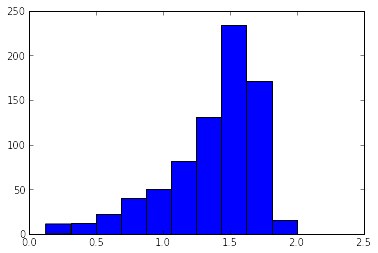

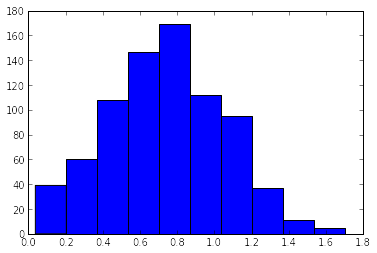

In [5]:
sys.path.append('/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/contrib/PushPullCCLISSOMModelSSIzL23NoRand')
from analysis_and_visualization import perform_analysis_and_visualization,analysis
analysis(data_store,l4_exc_or_many_analog,l4_exc_or_many_analog_inh,l23_exc_or_many_analog,l23_exc_or_many_analog_inh)
#data_store.save()

In [12]:
PSTH(param_filter_query(data_store),ParameterSet({'bin_length' : 20.0 })).analyse()

  Starting PSTH analysis
PSTH analysis took: 320.918732882seconds


In [20]:
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',analysis_algorithm='TrialAveragedFiringRate')    
CircularVarianceOfTuningCurve(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()


  Starting CircularVarianceOfTuningCurve analysis
CircularVarianceOfTuningCurve analysis took: 5.96438694seconds


In [62]:
sheets = list(set(['V1_Exc_L4','V1_Inh_L4','V1_Exc_L2/3','V1_Inh_L2/3']))
exc_sheets = list(set(['V1_Exc_L4','V1_Exc_L2/3']))

dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',sheet_name=sheets)   
Analog_F0andF1(dsv,ParameterSet({})).analyse()

TrialAveragedFiringRate(param_filter_query(data_store,sheet_name=sheets,st_name='FullfieldDriftingSinusoidalGrating'),ParameterSet({})).analyse()
TrialAveragedFiringRate(param_filter_query(data_store,st_direct_stimulation_name="None",st_name='InternalStimulus'),ParameterSet({})).analyse()

dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',analysis_algorithm='TrialAveragedFiringRate',sheet_name=sheets)    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()

dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',sheet_name=sheets)   
Analog_F0andF1(dsv,ParameterSet({})).analyse()


dsv = param_filter_query(data_store,st_name='InternalStimulus',st_direct_stimulation_name="None")
Analog_MeanSTDAndFanoFactor(dsv,ParameterSet({})).analyse()

pnv = param_filter_query(data_store,st_name='InternalStimulus',sheet_name='V1_Exc_L4',analysis_algorithm=['Analog_MeanSTDAndFanoFactor'],value_name='Mean(VM)',st_direct_stimulation_name='None').get_analysis_result()[0]
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',sheet_name='V1_Exc_L4',analysis_algorithm=['Analog_F0andF1'],value_name='F0_Vm')
OperationPNVfromPNVS(pnv,lambda x,y: -(x+y),'-(x+y)',dsv,ParameterSet({})).analyse()

pnv = param_filter_query(data_store,st_name='InternalStimulus',sheet_name='V1_Exc_L2/3',analysis_algorithm=['Analog_MeanSTDAndFanoFactor'],value_name='Mean(VM)',st_direct_stimulation_name='None').get_analysis_result()[0]
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',sheet_name='V1_Exc_L2/3',analysis_algorithm=['Analog_F0andF1'],value_name='F0_Vm')
OperationPNVfromPNVS(pnv,lambda x,y: -(x+y),'-(x+y)',dsv,ParameterSet({})).analyse()

dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',analysis_algorithm='TrialAveragedFiringRate',sheet_name=sheets)  
PeriodicTuningCurvePreferenceAndSelectivity_VectorAverage(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()

ModulationRatio(param_filter_query(data_store,sheet_name=exc_sheets,st_contrast=[100]),ParameterSet({})).analyse()


  Starting Analog_F0andF1 analysis
  Starting Analog_F0andF1 analysis
  Starting Analog_F0andF1 analysis


Analog_F0andF1 analysis took: 709.24405098seconds
Analog_F0andF1 analysis took: 709.24405098seconds
Analog_F0andF1 analysis took: 709.24405098seconds
  Starting TrialAveragedFiringRate analysis
  Starting TrialAveragedFiringRate analysis
  Starting TrialAveragedFiringRate analysis


TrialAveragedFiringRate analysis took: 130.653112888seconds
TrialAveragedFiringRate analysis took: 130.653112888seconds
TrialAveragedFiringRate analysis took: 130.653112888seconds
  Starting TrialAveragedFiringRate analysis
  Starting TrialAveragedFiringRate analysis
  Starting TrialAveragedFiringRate analysis


TrialAveragedFiringRate analysis took: 7.62381100655seconds
TrialAveragedFiringRate analysis took: 7.62381100655seconds
TrialAveragedFiringRate analysis took: 7.62381100655seconds
  Starting GaussianTuningCurveFit analysis
  Starting GaussianTuningCurveFit analysis
  Starting GaussianTuningCurveFit analysis


[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.09990009990009989, 0.09990009990009989, 0.049950049950049945, 0.19980019980019978, 0.29970029970029965, 0.54945054945054939, 0.49950049950049946, 0.89910089910089908]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.14985014985014983, 0.19980019980019978, 0.24975024975024973, 0.09990009990009989, 0.24975024975024973, 0.74925074925074919, 0.89910089910089896, 1.1988011988011986]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.14985014985014983, 0.89910089910089896, 0.14985014985014983, 1.9980019980019978, 1.6483516483516483, 0.49950049950049946, 0.14985014985014983, 0.14985014985014983]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207,

/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/scipy/optimize/minpack.py:402: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.09990009990009989, 0.09990009990009989, 0.19980019980019978, 0.24975024975024973, 0.39960039960039956, 0.59940059940059931, 0.24975024975024973, 0.59940059940059931]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.64935064935064934, 0.34965034965034963, 0.44955044955044948, 0.29970029970029965, 0.19980019980019978, 0.14985014985014983, 0.34965034965034963, 0.09990009990009989]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.5494505494505495, 0.09990009990009989, 0.24975024975024973, 0.09990009990009989, 0.049950049950049945, 0.0, 0.14985014985014983, 0.0]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.3926990

[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.049950049950049945, 0.19980019980019978, 0.14985014985014983, 0.59940059940059931, 0.49950049950049935, 0.49950049950049935, 0.14985014985014983, 0.39960039960039956]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[1.5484515484515482, 0.84915084915084904, 1.3486513486513485, 0.44955044955044948, 0.19980019980019978, 0.49950049950049946, 0.39960039960039956, 0.29970029970029965]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.19980019980019978, 0.24975024975024973, 0.49950049950049935, 0.14985014985014983, 0.34965034965034963, 1.4985014985014984, 1.2987012987012985, 1.6483516483516483]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0

[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.5494505494505495, 1.4485514485514486, 0.14985014985014983, 1.7482517482517479, 0.79920079920079901, 0.39960039960039956, 0.19980019980019978, 0.09990009990009989]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.74925074925074919, 1.0989010989010985, 0.29970029970029965, 0.89910089910089896, 0.64935064935064923, 0.19980019980019978, 0.24975024975024973, 0.24975024975024973]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.64935064935064923, 0.74925074925074919, 0.29970029970029965, 0.9990009990009987, 0.74925074925074919, 0.24975024975024973, 0.29970029970029965, 0.14985014985014983]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.

[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[1.9980019980019983, 1.5484515484515482, 1.3486513486513485, 0.49950049950049935, 0.29970029970029965, 0.19980019980019978, 0.44955044955044948, 0.09990009990009989]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.09990009990009989, 0.29970029970029965, 0.09990009990009989, 0.34965034965034963, 0.49950049950049946, 0.34965034965034963, 0.24975024975024973, 0.34965034965034963]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.34965034965034963, 0.49950049950049946, 0.049950049950049945, 0.69930069930069927, 0.09990009990009989, 0.09990009990009989, 0.09990009990009989, 0.049950049950049945]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207

[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.19980019980019978, 0.34965034965034963, 0.049950049950049945, 0.39960039960039956, 0.049950049950049945, 0.049950049950049945, 0.049950049950049945, 0.09990009990009989]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.74925074925074919, 0.09990009990009989, 0.39960039960039956, 0.049950049950049945, 0.049950049950049945, 0.14985014985014983, 0.09990009990009989, 0.19980019980019978]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.39960039960039956, 0.44955044955044948, 0.09990009990009989, 0.049950049950049945, 0.0, 0.09990009990009989, 0.0, 0.0]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.3926990816987241

[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.049950049950049945, 0.049950049950049945, 0.19980019980019978, 0.19980019980019978, 0.99900099900099892, 0.69930069930069927, 0.14985014985014983, 0.69930069930069938]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.99900099900099892, 1.2987012987012985, 0.69930069930069938, 0.69930069930069916, 0.19980019980019978, 0.0, 0.39960039960039956, 0.09990009990009989]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.89910089910089896, 0.5494505494505495, 1.048951048951049, 0.44955044955044948, 0.19980019980019978, 0.24975024975024973, 0.69930069930069927, 0.29970029970029965]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974

[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.049950049950049945, 0.0, 0.54945054945054927, 0.14985014985014983, 0.34965034965034963, 1.2487512487512487, 0.94905094905094889, 1.4485514485514484]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.39960039960039956, 0.19980019980019978, 0.49950049950049935, 0.24975024975024973, 0.14985014985014983, 1.3486513486513485, 1.2987012987012987, 1.6483516483516483]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.09990009990009989, 0.5494505494505495, 0.0, 0.69930069930069927, 0.69930069930069916, 0.24975024975024973, 0.049950049950049945, 0.14985014985014983]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169

[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.94905094905094889, 0.69930069930069927, 0.44955044955044948, 0.39960039960039956, 0.24975024975024973, 0.19980019980019978, 0.19980019980019978, 0.14985014985014983]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.34965034965034963, 0.44955044955044948, 0.24975024975024973, 1.1988011988011986, 1.048951048951049, 0.59940059940059931, 0.29970029970029965, 0.09990009990009989]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.049950049950049945, 0.0, 0.049950049950049945, 0.09990009990009989, 0.24975024975024973, 0.24975024975024973, 0.29970029970029965, 0.29970029970029965]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.785398163397

[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.54945054945054939, 0.39960039960039956, 0.69930069930069927, 0.09990009990009989, 0.0, 0.14985014985014983, 0.39960039960039956, 0.09990009990009989]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.24975024975024973, 0.79920079920079901, 0.09990009990009989, 1.1988011988011986, 0.64935064935064923, 0.39960039960039956, 0.049950049950049945, 0.0]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.14985014985014983, 0.29970029970029965, 0.19980019980019978, 0.64935064935064923, 1.0989010989010988, 0.74925074925074919, 0.29970029970029965, 0.29970029970029965]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908

[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.14985014985014983, 0.049950049950049945, 0.44955044955044948, 0.09990009990009989, 0.09990009990009989, 0.34965034965034963, 0.74925074925074919, 0.69930069930069938]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.19980019980019978, 0.49950049950049946, 0.049950049950049945, 0.59940059940059931, 0.59940059940059931, 0.64935064935064923, 0.049950049950049945, 0.34965034965034963]
[1.5707963267948966, 1.1780972450961724, 1.9634954084936207, 0.7853981633974483, 0.39269908169872414, 0.0, 2.356194490192345, 2.748893571891069]
[0.64935064935064923, 0.19980019980019978, 2.2977022977022985, 0.049950049950049945, 0.049950049950049945, 0.14985014985014983, 1.9980019980019974, 0.89910089910089896]
[1.5707963267948966, 1.1780972450961724, 1.963495408493

[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.49950049950049935, 0.44955044955044804, 0.09990009990009989, 0.0, 0.24975024975024973, 0.09990009990009989, 1.1488511488511486, 1.3486513486513483]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.84915084915084904, 0.34965034965034814, 0.49950049950049946, 0.09990009990009989, 0.09990009990009989, 0.14985014985014983, 0.99900099900099892, 1.1988011988011986]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.34965034965034963, 1.7982017982017922, 0.34965034965034963, 0.19980019980019978, 3.196803196803196, 1.3986013986013983, 0.09990009990009989, 0.74925074925074919]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 

[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[1.3486513486513485, 0.19980019980019978, 0.44955044955044948, 0.39960039960039956, 0.39960039960039956, 0.14985014985014983, 0.44955044955044948, 0.44955044955044948]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.69930069930069916, 0.0, 0.39960039960039956, 0.24975024975024973, 0.14985014985014983, 0.14985014985014983, 0.09990009990009989, 0.24975024975024973]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.049950049950049945, 0.49950049950049796, 0.19980019980019978, 0.34965034965034963, 0.84915084915084904, 0.949050949050949, 0.049950049950049945, 0.14985014985014983]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.570796326794

[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.29970029970029965, 3.3966033966033846, 0.09990009990009989, 0.39960039960039956, 3.5464535464535465, 1.1488511488511488, 0.5494505494505495, 1.6983016983016981]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[1.0989010989010988, 0.14985014985014983, 0.69930069930069916, 0.69930069930069916, 0.0, 0.19980019980019978, 0.99900099900099892, 0.24975024975024973]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.09990009990009989, 0.54945054945054939, 0.29970029970029965, 0.9990009990009987, 1.7482517482517479, 2.0979020979020975, 0.049950049950049945, 0.24975024975024973]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0

[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.79920079920079912, 0.049950049950049945, 0.64935064935064923, 0.19980019980019978, 0.049950049950049945, 0.14985014985014983, 0.44955044955044948, 0.14985014985014983]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.09990009990009989, 0.14985014985014838, 0.34965034965034963, 0.54945054945054939, 0.44955044955044948, 0.74925074925074919, 0.049950049950049945, 0.09990009990009989]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.79920079920079912, 0.24975024975024973, 2.0479520479520477, 2.3976023976023972, 0.24975024975024973, 0.64935064935064923, 0.34965034965034963, 0.29970029970029965]
[2.356194490192345, 0.39269908169872414, 1.96349540849362

[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[1.8481518481518477, 0.44955044955044665, 0.39960039960039956, 0.0, 0.19980019980019978, 0.0, 2.4975024975024978, 1.2987012987012985]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.049950049950049945, 0.34965034965034963, 0.09990009990009989, 0.34965034965034963, 0.49950049950049935, 0.44955044955044948, 0.09990009990009989, 0.14985014985014983]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.14985014985014983, 0.0, 0.34965034965034963, 0.74925074925074919, 0.0, 0.44955044955044948, 0.19980019980019978, 0.0]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 

[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.29970029970029965, 0.09990009990009989, 1.1488511488511486, 0.69930069930069916, 0.34965034965034963, 0.19980019980019978, 0.09990009990009989, 0.24975024975024973]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.19980019980019978, 0.49950049950049796, 0.39960039960039956, 0.64935064935064923, 0.79920079920079901, 1.0989010989010985, 0.24975024975024973, 0.19980019980019978]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.049950049950049945, 0.64935064935064923, 0.0, 0.0, 0.14985014985014983, 0.14985014985014983, 0.44955044955044948, 0.84915084915084904]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.78539816

[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.14985014985014983, 0.14985014985014983, 0.29970029970029965, 0.64935064935064923, 0.39960039960039956, 0.69930069930069927, 0.0, 0.049950049950049945]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.0, 2.4475524475524368, 0.09990009990009989, 0.14985014985014983, 1.7482517482517479, 0.39960039960039956, 0.59940059940059931, 1.7982017982017979]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.09990009990009989, 1.1988011988011968, 0.049950049950049945, 0.24975024975024973, 1.1488511488511488, 0.59940059940059931, 0.24975024975024973, 0.39960039960039956]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633

[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[1.3986013986013985, 0.19980019980019978, 0.74925074925074919, 0.84915084915084926, 0.24975024975024973, 0.19980019980019978, 1.1988011988011986, 0.44955044955044948]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.34965034965034963, 0.59940059940059776, 0.44955044955044948, 0.09990009990009989, 0.34965034965034963, 0.19980019980019978, 0.9990009990009987, 1.3486513486513487]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.19980019980019978, 1.0989010989010959, 0.14985014985014983, 0.49950049950049935, 2.4975024975024973, 1.9980019980019983, 0.29970029970029965, 0.64935064935064923]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.57

[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[1.048951048951049, 0.14985014985014838, 1.1988011988011986, 1.3486513486513485, 0.14985014985014983, 0.39960039960039956, 0.29970029970029965, 0.14985014985014983]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.14985014985014983, 0.29970029970029821, 0.34965034965034963, 0.84915084915084904, 1.1988011988011986, 1.2987012987012985, 0.0, 0.09990009990009989]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.7853981633974483, 1.1780972450961724, 2.748893571891069, 0.0]
[0.44955044955044948, 2.0979020979020917, 0.64935064935064923, 1.3486513486513487, 2.197802197802198, 1.9980019980019978, 0.24975024975024973, 0.14985014985014983]
[2.356194490192345, 0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 0.78

[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[1.1988011988011988, 1.048951048951049, 0.39960039960039956, 0.0, 0.29970029970029965, 1.898101898101898, 0.19980019980019978, 0.14985014985014983]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.0, 0.049950049950049945, 0.14985014985014983, 0.24975024975024973, 0.14985014985014983, 0.049950049950049945, 0.44955044955044948, 0.39960039960039956]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.0, 0.74925074925074919, 0.949050949050949, 0.34965034965034963, 0.0, 0.19980019980019978, 0.049950049950049945, 0.09990009990009989]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1

[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[3.1468531468531467, 4.8451548451548438, 2.7972027972027971, 2.1478521478521477, 2.1478521478521477, 5.4445554445554443, 1.9980019980019974, 1.8481518481518482]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.24975024975024973, 0.09990009990009989, 0.0, 0.14985014985014983, 0.34965034965034963, 0.14985014985014983, 0.34965034965034963, 0.09990009990009989]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[1.0489510489510487, 2.197802197802198, 4.2457542457542452, 4.1958041958041949, 0.74925074925074908, 1.048951048951049, 1.4985014985014982, 2.5474525474525476]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.785398163

[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.19980019980019978, 0.0, 0.049950049950049945, 0.09990009990009989, 0.19980019980019978, 0.049950049950049945, 0.44955044955044948, 0.24975024975024973]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[1.4985014985014984, 2.3476523476523474, 2.0479520479520472, 0.89910089910089908, 1.0989010989010988, 1.9480519480519483, 1.5484515484515484, 0.89910089910089908]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.29970029970029965, 0.049950049950049945, 0.09990009990009989, 0.09990009990009989, 1.098901098901099, 0.0, 1.0489510489510487, 0.34965034965034963]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.78539816339744

[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.949050949050949, 1.7482517482517479, 0.54945054945054939, 0.14985014985014983, 0.14985014985014983, 1.7482517482517483, 0.24975024975024973, 0.24975024975024973]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.049950049950049945, 1.5984015984015982, 1.4985014985014984, 0.09990009990009989, 0.0, 0.89910089910089896, 0.049950049950049945, 0.19980019980019978]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.14985014985014983, 0.14985014985014983, 0.049950049950049945, 0.049950049950049945, 0.39960039960039956, 0.049950049950049945, 0.14985014985014983, 0.0]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.785398163

[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.0, 0.34965034965034963, 0.59940059940059931, 1.0989010989010985, 0.14985014985014983, 0.24975024975024973, 0.69930069930069927, 1.1488511488511486]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.19980019980019978, 0.09990009990009989, 0.049950049950049945, 0.0, 0.14985014985014983, 0.19980019980019978, 0.64935064935064923, 0.09990009990009989]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.0, 0.29970029970029965, 0.24975024975024973, 0.09990009990009989, 0.0, 0.19980019980019978, 0.0, 0.09990009990009989]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.570796326794

[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[1.5484515484515486, 4.3956043956043942, 3.5964035964035959, 1.8981018981018978, 1.0989010989010988, 2.4475524475524475, 1.3986013986013985, 1.9480519480519476]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.74925074925074908, 0.94905094905094889, 1.0489510489510487, 2.2977022977022972, 0.49950049950049935, 1.098901098901099, 2.2477522477522478, 3.8961038961038961]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.0, 0.19980019980019978, 0.0, 0.0, 0.0, 0.0, 0.0, 0.049950049950049945]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[2.0979020979020979, 0

[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[1.6983016983016981, 2.4975024975024969, 1.2487512487512484, 0.84915084915084904, 0.54945054945054927, 2.6973026973026974, 0.59940059940059931, 0.79920079920079912]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.0, 0.0, 0.049950049950049945, 0.049950049950049945, 0.049950049950049945, 0.0, 0.34965034965034963, 0.24975024975024973]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[1.1488511488511488, 0.59940059940059931, 0.39960039960039956, 0.34965034965034963, 1.4485514485514486, 0.69930069930069916, 1.5984015984015982, 0.34965034965034963]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.178

[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.14985014985014983, 0.19980019980019978, 0.29970029970029965, 0.19980019980019978, 0.44955044955044948, 0.049950049950049945, 1.3486513486513485, 0.64935064935064923]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.049950049950049945, 0.94905094905094889, 0.14985014985014983, 0.049950049950049945, 0.0, 0.44955044955044948, 0.09990009990009989, 0.0]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[1.1488511488511488, 0.19980019980019978, 0.049950049950049945, 0.0, 1.4985014985014982, 0.24975024975024973, 0.84915084915084904, 0.14985014985014983]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 

[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.49950049950049935, 2.4975024975024973, 3.2467532467532463, 1.7482517482517483, 0.49950049950049946, 1.2487512487512484, 0.64935064935064923, 0.69930069930069916]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.049950049950049945, 0.49950049950049935, 0.49950049950049935, 0.14985014985014983, 0.09990009990009989, 0.19980019980019978, 0.049950049950049945, 0.049950049950049945]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.09990009990009989, 0.54945054945054927, 0.19980019980019978, 0.0, 0.049950049950049945, 0.24975024975024973, 0.0, 0.0]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1

[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.49950049950049935, 0.049950049950049945, 0.0, 0.049950049950049945, 0.09990009990009989, 0.24975024975024973, 0.049950049950049945, 0.09990009990009989]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.84915084915084904, 0.34965034965034963, 0.79920079920079912, 1.1488511488511488, 0.44955044955044948, 0.49950049950049946, 1.0989010989010985, 1.5984015984015982]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[2.7972027972027975, 2.4975024975024978, 1.8481518481518477, 1.3986013986013985, 1.7982017982017979, 2.7472527472527473, 1.4985014985014984, 1.4985014985014984]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.

[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[0.14985014985014983, 0.79920079920079901, 0.69930069930069927, 0.44955044955044948, 0.0, 0.94905094905094889, 0.19980019980019978, 0.24975024975024973]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[1.4485514485514481, 0.24975024975024973, 0.34965034965034963, 0.19980019980019978, 2.4475524475524475, 0.34965034965034963, 0.54945054945054939, 0.29970029970029965]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.7853981633974483, 0.0, 1.1780972450961724, 1.5707963267948966]
[3.446553446553446, 3.2467532467532463, 2.4975024975024969, 1.6483516483516483, 1.2487512487512487, 6.3436563436563436, 1.1488511488511488, 0.84915084915084904]
[0.39269908169872414, 2.748893571891069, 2.356194490192345, 1.9634954084936207, 0.78

[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.14985014985014983, 0.049950049950049945, 0.09990009990009989, 1.2987012987012914, 0.049950049950049945, 0.19980019980019978, 1.8981018981018978, 1.148851148851149]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.29970029970029965, 0.59940059940059931, 0.44955044955044948, 0.09990009990009989, 0.049950049950049945, 0.09990009990009989, 0.0, 0.0]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.19980019980019978, 0.09990009990009989, 0.0, 0.049950049950049945, 1.6483516483516483, 0.0, 0.24975024975024973, 1.0489510489510487]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0

[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[3.1968031968031965, 1.5984015984015982, 1.5984015984015985, 1.4985014985014937, 5.4445554445554443, 0.89910089910089896, 1.6983016983016981, 4.2957042957042946]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.0, 0.0, 0.0, 0.049950049950049945, 0.14985014985014983, 0.0, 0.0, 0.14985014985014983]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[3.446553446553446, 4.0959040959040944, 3.2967032967032965, 0.94905094905094312, 1.6983016983016981, 1.5984015984015982, 0.94905094905094889, 1.2987012987012989]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[1.748

[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.79920079920079912, 0.69930069930069916, 0.39960039960039956, 0.0, 0.29970029970029965, 0.049950049950049945, 0.049950049950049945, 0.049950049950049945]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[3.046953046953047, 1.2987012987012987, 1.0489510489510487, 2.1978021978021918, 6.7932067932067941, 1.598401598401598, 3.2467532467532463, 6.4935064935064926]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.99900099900099892, 0.44955044955044948, 0.39960039960039956, 1.3486513486513443, 1.8481518481518477, 0.74925074925074908, 2.2477522477522474, 4.0959040959040953]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.3

[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.34965034965034963, 0.44955044955044948, 1.098901098901099, 1.8981018981018962, 0.14985014985014983, 3.3966033966033962, 0.49950049950049946, 0.049950049950049945]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[3.2467532467532463, 1.4985014985014984, 0.89910089910089908, 1.048951048951043, 5.894105894105893, 1.098901098901099, 3.6463536463536457, 7.392607392607391]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.14985014985014983, 0.09990009990009989, 0.09990009990009989, 0.69930069930069783, 0.9990009990009987, 0.14985014985014983, 3.2967032967032965, 3.8461538461538454]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.392699081698

[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.0, 0.09990009990009989, 0.44955044955044948, 1.5984015984015967, 0.049950049950049945, 1.6483516483516483, 0.949050949050949, 0.14985014985014983]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.09990009990009989, 0.09990009990009989, 0.0, 1.1488511488511459, 0.34965034965034963, 0.24975024975024973, 3.1468531468531467, 1.7482517482517479]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.049950049950049945, 0.09990009990009989, 0.49950049950049946, 0.69930069930069771, 0.0, 1.4485514485514486, 0.19980019980019978, 0.049950049950049945]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.78539816

/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/mozaik/analysis/analysis.py:774: RuntimeWarning: invalid value encountered in double_scalars
  if numpy.linalg.norm(fitfunc(p1,X)-Y,2)/numpy.linalg.norm(Y-numpy.mean(Y),2) > 0.2:


[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[1.8981018981018978, 0.64935064935064934, 0.09990009990009989, 0.09990009990009989, 1.4985014985014984, 0.09990009990009989, 0.14985014985014983, 0.84915084915084926]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.09990009990009989, 0.09990009990009989, 0.049950049950049945, 0.74925074925074764, 0.09990009990009989, 0.89910089910089896, 0.14985014985014983, 0.0]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.49950049950049935, 0.74925074925074908, 1.4485514485514484, 3.246753246753241, 0.79920079920079912, 4.5954045954045952, 1.2487512487512484, 0.5494505494505495]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414,

[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[2.0479520479520481, 1.1988011988011986, 2.947052947052947, 4.9450549450549355, 1.8481518481518477, 5.394605394605394, 2.197802197802198, 2.0479520479520477]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.19980019980019978, 0.19980019980019978, 0.34965034965034963, 2.9470529470529399, 0.5494505494505495, 0.949050949050949, 4.9450549450549444, 2.7972027972027975]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.34965034965034963, 0.049950049950049945, 0.09990009990009989, 0.69930069930069771, 0.49950049950049946, 0.049950049950049945, 1.8981018981018978, 0.49950049950049935]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169

[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.54945054945054939, 0.39960039960039956, 2.2477522477522478, 3.9960039960039828, 0.79920079920079901, 6.0939060939060941, 1.7982017982017979, 0.79920079920079912]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.59940059940059931, 1.5484515484515482, 2.0979020979020975, 0.29970029970029677, 0.39960039960039956, 1.098901098901099, 0.19980019980019978, 0.14985014985014983]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[1.098901098901099, 1.7482517482517479, 2.3976023976023972, 0.09990009990009989, 0.44955044955044948, 1.0989010989010988, 0.34965034965034963, 0.29970029970029965]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908

[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.09990009990009989, 0.0, 0.34965034965034963, 0.59940059940059631, 0.0, 0.54945054945054939, 0.24975024975024973, 0.19980019980019978]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.99900099900099892, 0.34965034965034963, 0.09990009990009989, 0.049950049950049945, 0.39960039960039956, 0.19980019980019978, 0.049950049950049945, 0.09990009990009989]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.49950049950049935, 0.34965034965034963, 0.14985014985014983, 0.049950049950049945, 0.19980019980019978, 0.0, 0.0, 0.09990009990009989]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483

[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.049950049950049945, 0.09990009990009989, 0.09990009990009989, 1.3486513486513452, 0.0, 1.1988011988011986, 0.5994005994005992, 0.39960039960039956]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.9990009990009987, 1.0989010989010988, 0.54945054945054927, 1.8981018981018938, 0.74925074925074919, 1.0489510489510487, 3.0469530469530466, 1.4485514485514484]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 2.356194490192345, 0.7853981633974483, 0.0, 2.748893571891069]
[0.049950049950049945, 0.09990009990009989, 0.34965034965034963, 0.49950049950049513, 0.09990009990009989, 0.79920079920079901, 0.24975024975024973, 0.14985014985014983]
[1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414,

[0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 2.748893571891069, 2.356194490192345, 0.7853981633974483, 0.0]
[2.5474525474525476, 2.7972027972027975, 3.8461538461538454, 4.5954045954045952, 1.3986013986013983, 2.197802197802198, 3.3466533466533464, 2.0479520479520477]
[0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 2.748893571891069, 2.356194490192345, 0.7853981633974483, 0.0]
[3.6963036963036964, 2.8471528471528473, 2.7972027972027971, 3.546453546453546, 1.6983016983016981, 1.4485514485514486, 3.8961038961038961, 2.697302697302697]
[0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 2.748893571891069, 2.356194490192345, 0.7853981633974483, 0.0]
[5.6443556443556435, 2.6473526473526476, 1.9480519480519476, 2.5474525474525471, 5.2947052947052944, 3.6963036963036955, 3.6463536463536457, 6.2937062937062933]
[0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 2.7

[0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 2.748893571891069, 2.356194490192345, 0.7853981633974483, 0.0]
[4.1458541458541447, 1.6983016983016981, 2.1478521478521477, 1.5484515484515482, 3.2967032967032965, 2.2977022977022976, 2.8471528471528464, 4.2957042957042955]
[0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 2.748893571891069, 2.356194490192345, 0.7853981633974483, 0.0]
[4.1458541458541456, 3.6463536463536457, 5.9440559440559433, 6.8431568431568426, 3.0969030969030968, 2.4475524475524475, 5.4445554445554452, 2.6973026973026974]
[0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 2.748893571891069, 2.356194490192345, 0.7853981633974483, 0.0]
[4.895104895104895, 2.5974025974025978, 2.0479520479520477, 2.7472527472527473, 5.5944055944055933, 3.546453546453546, 3.4965034965034958, 5.394605394605394]
[0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 2.7

[0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 2.748893571891069, 2.356194490192345, 0.7853981633974483, 0.0]
[5.2947052947052944, 1.898101898101898, 1.948051948051948, 2.7972027972027975, 2.3976023976023972, 2.1478521478521477, 4.5954045954045952, 2.6473526473526467]
[0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 2.748893571891069, 2.356194490192345, 0.7853981633974483, 0.0]
[5.394605394605394, 2.4975024975024973, 3.546453546453546, 4.895104895104895, 2.4475524475524475, 2.7472527472527468, 7.2427572427572411, 2.3476523476523474]
[0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 2.748893571891069, 2.356194490192345, 0.7853981633974483, 0.0]
[2.0479520479520481, 2.197802197802198, 3.5964035964035959, 3.8461538461538458, 1.948051948051948, 1.2487512487512489, 2.0979020979020975, 2.0479520479520472]
[0.39269908169872414, 1.9634954084936207, 1.5707963267948966, 1.1780972450961724, 2.74889

[1.5707963267948966, 0.39269908169872414, 1.1780972450961724, 0.7853981633974483, 2.356194490192345, 2.748893571891069, 0.0, 1.9634954084936207]
[5.1448551448551445, 3.6963036963036826, 6.3936063936063938, 4.8451548451548438, 2.4475524475524475, 1.7982017982017979, 1.9980019980019974, 4.1958041958041949]
[1.5707963267948966, 0.39269908169872414, 1.1780972450961724, 0.7853981633974483, 2.356194490192345, 2.748893571891069, 0.0, 1.9634954084936207]
[4.6953046953046949, 5.09490509490508, 4.845154845154843, 4.7452547452547451, 2.4975024975024978, 2.0479520479520477, 3.3466533466533464, 3.446553446553446]
[1.5707963267948966, 0.39269908169872414, 1.1780972450961724, 0.7853981633974483, 2.356194490192345, 2.748893571891069, 0.0, 1.9634954084936207]
[2.6973026973026974, 6.8431568431568195, 2.8971028971028967, 4.1458541458541447, 3.9960039960039957, 6.593406593406594, 9.3906093906093897, 3.0969030969030968]
[1.5707963267948966, 0.39269908169872414, 1.1780972450961724, 0.7853981633974483, 2.356

[1.5707963267948966, 0.39269908169872414, 1.1780972450961724, 0.7853981633974483, 2.356194490192345, 2.748893571891069, 0.0, 1.9634954084936207]
[1.948051948051948, 3.046953046953039, 1.8481518481518477, 2.0479520479520477, 6.6433566433566424, 8.9910089910089894, 7.3426573426573416, 3.2967032967032965]
[1.5707963267948966, 0.39269908169872414, 1.1780972450961724, 0.7853981633974483, 2.356194490192345, 2.748893571891069, 0.0, 1.9634954084936207]
[1.6483516483516485, 4.7952047952047812, 2.0479520479520481, 1.6983016983016981, 4.5954045954045935, 6.6933066933066927, 8.6413586413586412, 2.4475524475524475]
[1.5707963267948966, 0.39269908169872414, 1.1780972450961724, 0.7853981633974483, 2.356194490192345, 2.748893571891069, 0.0, 1.9634954084936207]
[2.5474525474525476, 5.5444555444555181, 2.4475524475524475, 2.7972027972027971, 3.1968031968031965, 4.7452547452547442, 7.7922077922077904, 2.7972027972027975]
[1.5707963267948966, 0.39269908169872414, 1.1780972450961724, 0.7853981633974483, 2.

[0.0, 2.356194490192345, 1.1780972450961724, 2.748893571891069, 1.9634954084936207, 0.39269908169872414, 0.7853981633974483, 1.5707963267948966]
[5.394605394605394, 2.6473526473526467, 6.7932067932067923, 3.8461538461538458, 2.6473526473526476, 6.7432567432567421, 6.893106893106892, 4.3456543456543439]
[0.0, 2.356194490192345, 1.1780972450961724, 2.748893571891069, 1.9634954084936207, 0.39269908169872414, 0.7853981633974483, 1.5707963267948966]
[2.6473526473526467, 2.4475524475524471, 8.5414585414585407, 2.0979020979020975, 4.3456543456543439, 3.5964035964035959, 5.544455544455543, 9.2407592407592425]
[0.0, 2.356194490192345, 1.1780972450961724, 2.748893571891069, 1.9634954084936207, 0.39269908169872414, 0.7853981633974483, 1.5707963267948966]
[3.546453546453546, 3.046953046953047, 6.4435564435564432, 2.7472527472527473, 4.1458541458541447, 3.7962037962037956, 4.1458541458541447, 6.7932067932067923]
[0.0, 2.356194490192345, 1.1780972450961724, 2.748893571891069, 1.9634954084936207, 0.3

[0.0, 2.356194490192345, 1.1780972450961724, 2.748893571891069, 1.9634954084936207, 0.39269908169872414, 0.7853981633974483, 1.5707963267948966]
[11.688311688311689, 8.6913086913086879, 2.9970029970029968, 13.636363636363635, 4.4455544455544445, 5.9940059940059935, 3.0969030969030973, 2.8971028971028971]
[0.0, 2.356194490192345, 1.1780972450961724, 2.748893571891069, 1.9634954084936207, 0.39269908169872414, 0.7853981633974483, 1.5707963267948966]
[11.938061938061939, 4.0959040959040944, 3.1468531468531471, 7.2427572427572411, 3.446553446553446, 9.6403596403596392, 5.5944055944055942, 3.3466533466533464]
[0.0, 2.356194490192345, 1.1780972450961724, 2.748893571891069, 1.9634954084936207, 0.39269908169872414, 0.7853981633974483, 1.5707963267948966]
[3.046953046953047, 1.9980019980019978, 6.3936063936063938, 2.0479520479520477, 3.446553446553446, 6.0439560439560429, 8.3416583416583414, 5.3446553446553438]
[0.0, 2.356194490192345, 1.1780972450961724, 2.748893571891069, 1.9634954084936207, 0

[0.0, 2.356194490192345, 1.1780972450961724, 2.748893571891069, 1.9634954084936207, 0.39269908169872414, 0.7853981633974483, 1.5707963267948966]
[7.0429570429570418, 2.4975024975024978, 4.895104895104895, 4.5954045954045935, 2.6473526473526476, 7.5424575424575409, 6.7432567432567421, 3.7462537462537453]
[0.0, 2.356194490192345, 1.1780972450961724, 2.748893571891069, 1.9634954084936207, 0.39269908169872414, 0.7853981633974483, 1.5707963267948966]
[3.5964035964035959, 6.1938061938061928, 6.7432567432567412, 4.1958041958041949, 7.0929070929070921, 3.5964035964035959, 4.3456543456543457, 6.3936063936063938]
[0.0, 2.356194490192345, 1.1780972450961724, 2.748893571891069, 1.9634954084936207, 0.39269908169872414, 0.7853981633974483, 1.5707963267948966]
[9.7402597402597397, 9.5404595404595405, 3.1468531468531467, 12.037962037962039, 6.2937062937062942, 4.9950049950049955, 2.5474525474525476, 4.6453546453546446]
[0.0, 2.356194490192345, 1.1780972450961724, 2.748893571891069, 1.9634954084936207,

[2.748893571891069, 0.39269908169872414, 1.9634954084936207, 2.356194490192345, 0.0, 1.5707963267948966, 1.1780972450961724, 0.7853981633974483]
[5.0949050949050942, 9.540459540459505, 3.6963036963036955, 3.1968031968031965, 9.4905094905094884, 6.4435564435564432, 9.44055944055944, 9.9400599400599408]
[2.748893571891069, 0.39269908169872414, 1.9634954084936207, 2.356194490192345, 0.0, 1.5707963267948966, 1.1780972450961724, 0.7853981633974483]
[2.347652347652347, 5.0449550449550271, 6.0439560439560438, 3.2967032967032956, 3.4965034965034958, 11.638361638361639, 10.989010989010989, 8.4415584415584402]
[2.748893571891069, 0.39269908169872414, 1.9634954084936207, 2.356194490192345, 0.0, 1.5707963267948966, 1.1780972450961724, 0.7853981633974483]
[2.9970029970029972, 4.7452547452547309, 5.6443556443556444, 3.3966033966033962, 4.0959040959040944, 9.290709290709291, 8.1918081918081924, 5.9940059940059935]
[2.748893571891069, 0.39269908169872414, 1.9634954084936207, 2.356194490192345, 0.0, 1.

[2.748893571891069, 0.39269908169872414, 1.9634954084936207, 2.356194490192345, 0.0, 1.5707963267948966, 1.1780972450961724, 0.7853981633974483]
[16.483516483516478, 8.0419580419580239, 6.9430569430569422, 11.138861138861138, 14.835164835164836, 5.1448551448551445, 4.8451548451548447, 4.4955044955044947]
[2.748893571891069, 0.39269908169872414, 1.9634954084936207, 2.356194490192345, 0.0, 1.5707963267948966, 1.1780972450961724, 0.7853981633974483]
[6.893106893106892, 10.739260739260711, 4.4955044955044947, 5.394605394605394, 13.636363636363635, 4.3956043956043951, 5.9940059940059935, 7.7422577422577401]
[2.748893571891069, 0.39269908169872414, 1.9634954084936207, 2.356194490192345, 0.0, 1.5707963267948966, 1.1780972450961724, 0.7853981633974483]
[3.9960039960039948, 6.0439560439560296, 9.2407592407592407, 4.545454545454545, 3.546453546453546, 17.732267732267729, 14.885114885114888, 9.6903096903096877]
[2.748893571891069, 0.39269908169872414, 1.9634954084936207, 2.356194490192345, 0.0, 1

[2.748893571891069, 0.39269908169872414, 1.9634954084936207, 2.356194490192345, 0.0, 1.5707963267948966, 1.1780972450961724, 0.7853981633974483]
[4.545454545454545, 5.6943056943056769, 5.5944055944055942, 3.6463536463536457, 5.744255744255744, 11.238761238761237, 12.337662337662337, 9.1908091908091869]
[2.748893571891069, 0.39269908169872414, 1.9634954084936207, 2.356194490192345, 0.0, 1.5707963267948966, 1.1780972450961724, 0.7853981633974483]
[2.5474525474525476, 3.5964035964035888, 8.6413586413586394, 4.8451548451548447, 2.5474525474525471, 14.085914085914087, 11.688311688311689, 6.2437562437562431]
[2.748893571891069, 0.39269908169872414, 1.9634954084936207, 2.356194490192345, 0.0, 1.5707963267948966, 1.1780972450961724, 0.7853981633974483]
[7.7922077922077921, 3.9960039960039837, 9.1908091908091887, 8.9910089910089912, 3.9460539460539459, 9.0909090909090882, 4.9450549450549444, 3.8461538461538454]
[2.748893571891069, 0.39269908169872414, 1.9634954084936207, 2.356194490192345, 0.0,

GaussianTuningCurveFit analysis took: 18.2621810436seconds
GaussianTuningCurveFit analysis took: 18.2621810436seconds
GaussianTuningCurveFit analysis took: 18.2621810436seconds
  Starting Analog_F0andF1 analysis
  Starting Analog_F0andF1 analysis
  Starting Analog_F0andF1 analysis


Analog_F0andF1 analysis took: 202.770238876seconds
Analog_F0andF1 analysis took: 202.770238876seconds
Analog_F0andF1 analysis took: 202.770238876seconds
  Starting Analog_MeanSTDAndFanoFactor analysis
  Starting Analog_MeanSTDAndFanoFactor analysis
  Starting Analog_MeanSTDAndFanoFactor analysis


/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/mozaik/analysis/analysis.py:1100: RuntimeWarning: invalid value encountered in double_scalars
  esyn_fano_factor = numpy.array([std**2/abs(mean) for (std,mean) in zip(esyn_std,esyn_mean)])
/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/mozaik/analysis/analysis.py:1101: RuntimeWarning: invalid value encountered in double_scalars
  isyn_fano_factor = numpy.array([std**2/abs(mean) for (std,mean) in zip(isyn_std,isyn_mean)])


Analog_MeanSTDAndFanoFactor analysis took: 20.8667721748seconds
Analog_MeanSTDAndFanoFactor analysis took: 20.8667721748seconds
Analog_MeanSTDAndFanoFactor analysis took: 20.8667721748seconds


TypeError: unbound method __init__() must be called with Analysis instance as first argument (got OperationPNVfromPNVS instance instead)

In [2]:
dsv = param_filter_query(data_store,sheet_name=['V1_Exc_L2/3','V1_Exc_L4'])
ActionPotentialRemoval(dsv,ParameterSet({'window_length': 3.0})).analyse()

  Starting ActionPotentialRemoval analysis


ActionPotentialRemoval analysis took: 876.930622101seconds


In [3]:
dsv = param_filter_query(data_store,analysis_algorithm='ActionPotentialRemoval')
TrialVariability(data_store,ParameterSet({'vm': True,  'cond_exc': False, 'cond_inh': False})).analyse()


  Starting TrialVariability analysis


/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/numpy/core/_methods.py:94: RuntimeWarning: invalid value encountered in true_divide
  out=ret, casting='unsafe', subok=False)


TrialVariability analysis took: 958.409364939seconds


  Starting GaussianTuningCurveFit analysis


CCCC


/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/mozaik/analysis/analysis.py:786: RuntimeWarning: invalid value encountered in double_scalars
  pylab.plot(X,fitfunc(p1,X),'x')
/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/mozaik/analysis/analysis.py:796: RuntimeWarning: invalid value encountered in double_scalars
  import pylab


GaussianTuningCurveFit analysis took: 90.0592119694seconds


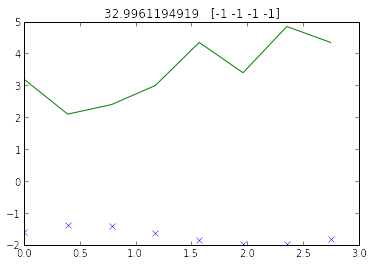

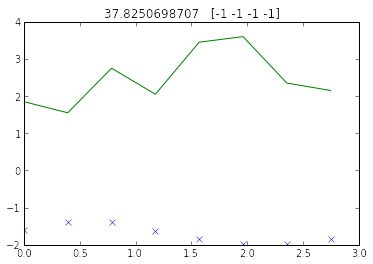

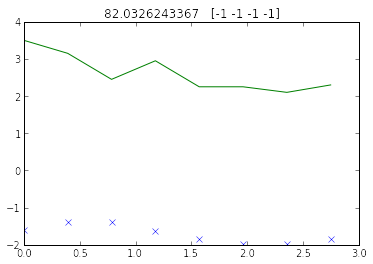

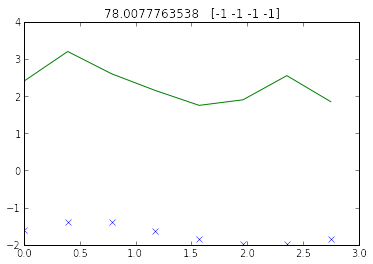

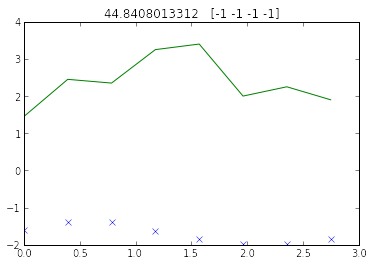

...

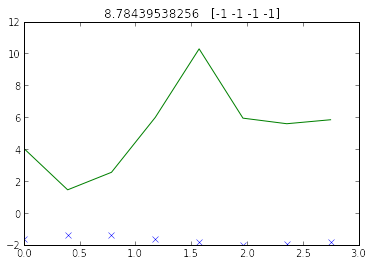

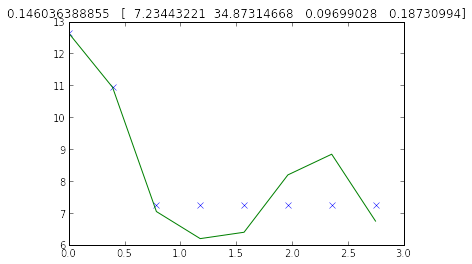

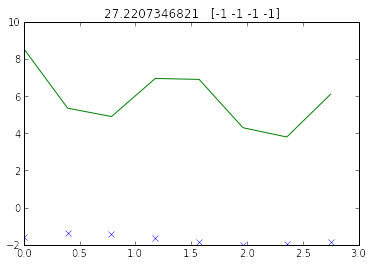

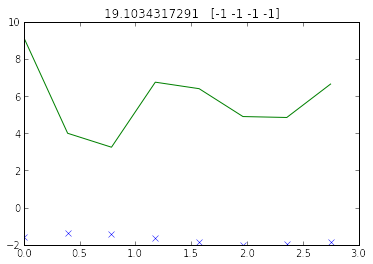

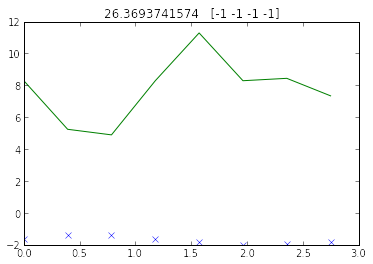

In [147]:
sheets = list(set(['V1_Exc_L4','V1_Inh_L4','V1_Exc_L2/3','V1_Inh_L2/3']))
#del mozaik.analysis.analysis
#sys.path.insert(0,'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik')PerNeuronValuePlot
reload(mozaik.analysis.analysis)
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',analysis_algorithm='TrialAveragedFiringRate',value_name='Firing rate',sheet_name=sheets)    
mozaik.analysis.analysis.GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()


In [29]:
a = [-1,1,2,float('NaN')]
pylab.argmin(a)

3

In [8]:
dsv = queries.param_filter_query(data_store,value_name=['orientation HWHH of Firing rate'],sheet_name=['V1_Exc_L4'],st_contrast=[100])    
print "L4Exc Mean HWHH:", numpy.mean(dsv.get_analysis_result()[0].values)
print numpy.mean(dsv.get_analysis_result()[0].values[dsv.get_analysis_result()[0].values>0])

L4Exc Mean HWHH: -33.6180273011
21.6506894219


In [48]:
print sys.path
import mozaik
print mozaik.__file__
import mozaik.analysis.analysis
print mozaik.analysis.__file__

['/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/imagen/../holoviews', '/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/imagen/../param', '/home/antolikjan/projects/mozaik/contrib', '', '/home/antolikjan/virt_env/oldmozaik/lib/python2.7', '/home/antolikjan/virt_env/oldmozaik/lib/python2.7/plat-x86_64-linux-gnu', '/home/antolikjan/virt_env/oldmozaik/lib/python2.7/lib-tk', '/home/antolikjan/virt_env/oldmozaik/lib/python2.7/lib-old', '/home/antolikjan/virt_env/oldmozaik/lib/python2.7/lib-dynload', '/usr/lib/python2.7', '/usr/lib/python2.7/plat-x86_64-linux-gnu', '/usr/lib/python2.7/lib-tk', '/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages', '/home/antolikjan/virt_env/oldmozaik/lib/python2.7/site-packages', '/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/IPython/extensions', '/home/antolikjan/.ipython']
/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/mozaik/__init__.pyc
/home/ant

In [49]:
ls /home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/mozaik/analysis

analysis.py          helper_functions.py   spontaneous_activity.py   vision.py
analysis.pyc         helper_functions.pyc  spontaneous_activity.pyc  vision.pyc
data_structures.py   __init__.py           technical.py
data_structures.pyc  __init__.pyc          technical.pyc


In [25]:

dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating')
Analog_MeanSTDAndFanoFactor(dsv,ParameterSet({})).analyse()


  Starting Analog_MeanSTDAndFanoFactor analysis
Analog_MeanSTDAndFanoFactor analysis took: 355.481365919seconds


In [26]:
xx = data_store.get_sheet_indexes(sheet_name='V1_Exc_L4',neuron_ids=analog_ids)
x = data_store.get_neuron_postions()['V1_Exc_L4'][0][xx]
y = data_store.get_neuron_postions()['V1_Exc_L4'][1][xx]
numpy.sqrt(numpy.multiply(x,x)+numpy.multiply(y,y)) < 0.3)[0]


SyntaxError: invalid syntax (<ipython-input-26-9086de5c0ac0>, line 4)

In [56]:
sys.path.insert(0,'/home/antolikjan/projects/mozaik/contrib')
import lsv1m_paper
reload(lsv1m_paper)

lsv1m_paper.ORMapReference(data_store,ParameterSet({}),fig_param={'figsize': (19,9.5), 'dpi' : 150}).plot({'*.dot_size' : 15,'*.fontsize' : 19})

AttributeError: 'module' object has no attribute 'ORMapReference'

In [ ]:
dsv = param_filter_query(data_store,sheet_name=['V1_Exc_L2/3','V1_Inh_L2/3'],analysis_algorithm='PeriodicTuningCurvePreferenceAndSelectivity_VectorAverage',st_contrast=100)    
PerNeuronValuePlot(dsv,ParameterSet({"cortical_view" : True}),fig_param={'figsize': (20,20)},plot_file_name='ORComputed.png').plot()
            

In [24]:
orr = list(set([MozaikParametrized.idd(s).orientation for s in queries.param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',st_contrast=100).get_stimuli()]))                

l23_exc_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Exc_L2/3')[0]
l23_inh_or = data_store.get_analysis_result(identifier='PerNeuronValue',value_name = 'LGNAfferentOrientation', sheet_name = 'V1_Inh_L2/3')[0]


l4_exc_or_many_analog = numpy.array(analog_ids)[numpy.nonzero(numpy.array([circular_dist(l4_exc_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids]) < 0.1)[0]]
l4_inh_or_many_analog = numpy.array(analog_ids_inh)[numpy.nonzero(numpy.array([circular_dist(l4_inh_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids_inh]) < 0.15)[0]]
    

l23_inh_or_many_analog = numpy.array(analog_ids_inh23)[numpy.nonzero(numpy.array([circular_dist(l23_inh_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids_inh23]) < 0.1)[0]]
l23_exc_or_many_analog = numpy.array(analog_ids23)[numpy.nonzero(numpy.array([circular_dist(l23_exc_or.get_value_by_id(i),0,numpy.pi)  for i in analog_ids23]) < 0.15)[0]]


  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, '

  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#84

  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color'

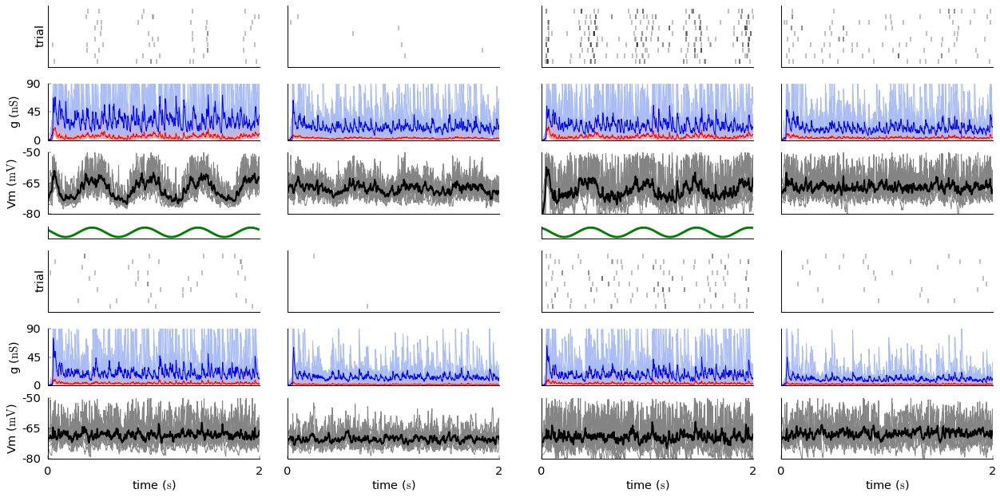

In [57]:
import lsv1m_paper
reload(lsv1m_paper)

lsv1m_paper.LSV1MReponseOverview(data_store,ParameterSet
({'l4_exc_neuron' : l4_exc_or_many_analog[5], 'l4_inh_neuron' : l4_inh_or_many_analog[8],'l23_exc_neuron' : l23_exc_or_many_analog[0], 'l23_inh_neuron' : l23_inh_or_many_analog[4]}),
                                 fig_param={'dpi' : 70,'figsize': (18,9)},plot_file_name='SingleCellOverview.png').plot(
                                    {'*.x_ticks':[0,2.0], 
                                     "*.title" : None,
                                     '*.Vm_plot.y_lim' : (-80,-50),
                                     '*.Conductance_plot.y_lim' : (0,90),
                                     })

In [58]:
dsv = queries.param_filter_query(data_store,sheet_name=['V1_Inh_L4'],st_contrast=[100],st_orientation=0)

e = []
i = []
for s in dsv.get_segments():
    for idd in l4_inh_or_many_analog:
        e.append(s.get_esyn(idd))
        i.append(s.get_isyn(idd))
print numpy.mean(e)
print numpy.mean(i)


0.00602358786835
0.0227189892225


[ -3.27161013e-03   2.49623227e-02   1.42546937e-02  -9.41765691e-03
  -2.71227818e-02   2.95457992e-02   2.88109695e-02  -6.00532316e-02
  -5.28920091e-02   1.14554319e-01  -4.97920876e-02   7.35168306e-02
   6.21339478e-03   6.76718929e-02   3.66587598e-02   1.05017613e-02
  -1.56158509e-01   6.71555500e-02   8.74450427e-03  -5.33935313e-02
  -3.22565881e-02  -8.15074536e-02  -6.72620141e-03  -3.49707622e-02
  -8.30336360e-02  -9.01064221e-03   8.54504201e-02   8.09248757e-04
  -1.61056828e-01  -1.64746245e-03  -2.91649613e-02   4.65445604e-02
  -1.49914642e-02  -1.47761317e-02   6.57503329e-02  -1.08135226e-01
  -9.85226064e-02   1.55992460e-02   4.00290750e-02   4.27802498e-02
   1.40942982e-02  -9.95091620e-03  -1.18182029e-01  -3.96975749e-02
   1.09571356e-02   3.23361963e-02  -6.22715115e-02   5.01412873e-03
  -7.97929342e-02   1.81052217e-02  -1.32849696e-01  -4.56287139e-02
  -8.28897630e-02  -3.86695377e-02  -1.11369064e-01  -1.22598722e-01
  -2.10418917e-01  -3.12630127e-02

  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, '

L4Exc Mean RURA: 2.34685129991
L4Inh Mean RURA: 13.3098765614
L23Exc Mean RURA: -3.12803220155
L23Inh Mean RURA: 17.5287982402
Exc RURA: -0.380337859991
Inh RURA: 15.3465973719


  {'color': (0, 0, 0), 'linestyle': '--', 'label': 'spont.'}
  {'color': (0, 0.45, 0.7), 'linestyle': '-', 'label': 'contrast : 10'}
  {'color': (0.9, 0.6, 0), 'linestyle': '-', 'label': 'contrast : 100'}
  {'color': (0, 0, 0), 'linestyle': '--', 'label': 'spont.'}
  {'color': (0, 0.45, 0.7), 'linestyle': '-', 'label': 'contrast : 10'}
  {'color': (0.9, 0.6, 0), 'linestyle': '-', 'label': 'contrast : 100'}
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True,

  {'color': (0, 0, 0), 'linestyle': '--', 'label': 'spont.'}
  {'color': (0, 0.45, 0.7), 'linestyle': '-', 'label': 'contrast : 10'}
  {'color': (0.9, 0.6, 0), 'linestyle': '-', 'label': 'contrast : 100'}
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': N

  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, '

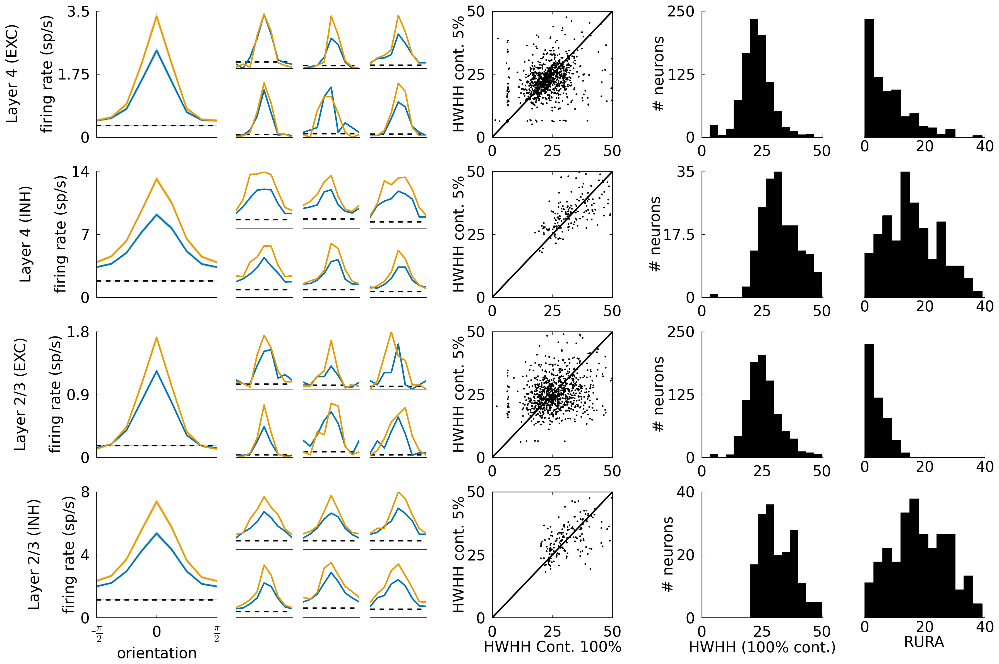

In [156]:
sys.path.insert(0,'/home/antolikjan/projects/mozaik/contrib')
import lsv1m_paper
reload(lsv1m_paper)

lsv1m_paper.OrientationTuningSummaryFiringRates(data_store,ParameterSet({'exc_sheet_name1': 'V1_Exc_L4','inh_sheet_name1': 'V1_Inh_L4','exc_sheet_name2': 'V1_Exc_L2/3','inh_sheet_name2': 'V1_Inh_L2/3'}),fig_param={'dpi' : 200,'figsize': (18,12)},plot_file_name='OrientationTuningSummary.png').plot({'*.HistogramPlot.num_bins' : int(15),'*.fontsize' : 19})            

In [42]:
reload(lsv1m_paper)
lsv1m_paper.OrientationTuningSummaryFiringRatesNew(data_store,ParameterSet({'exc_sheet_name1': 'V1_Exc_L4','inh_sheet_name1': 'V1_Inh_L4','exc_sheet_name2': 'V1_Exc_L2/3','inh_sheet_name2': 'V1_Inh_L2/3'}),fig_param={'dpi' : 200,'figsize': (18,12)},plot_file_name='OrientationTuningSummary.png').plot({'*.HistogramPlot.num_bins' : int(15),'*.fontsize' : 19})            

TypeError: unsupported operand type(s) for /: 'list' and 'list'

In [40]:
a = numpy.array([1,2,3,4])

numpy.logical_and(a>3,a<5)

array([False, False, False,  True], dtype=bool)

In [179]:
import mozaik.analysis.vision
reload(mozaik.analysis.vision)
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',sheet_name=['V1_Exc_L2/3','V1_Exc_L4','V1_Inh_L2/3','V1_Inh_L4'])
mozaik.analysis.vision.Analog_F0andF1(dsv,ParameterSet({})).analyse()


  Starting Analog_F0andF1 analysis


Analog_F0andF1 analysis took: 202.370101929seconds


/home/antolikjan/projects/mozaik/contrib/lsv1m_paper.py
51 93


  73
  692


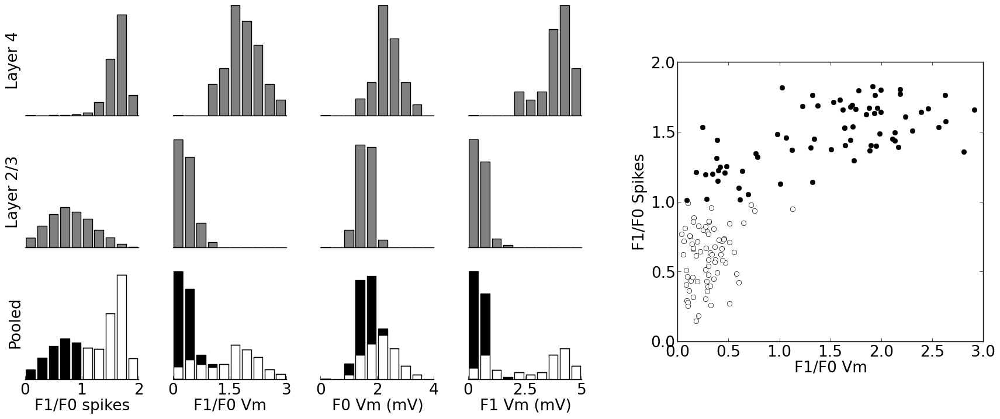

In [180]:
#sys.path.insert(0,'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/contrib')
sys.path.insert(0,'/home/antolikjan/projects/mozaik/contrib')
import lsv1m_paper
reload(lsv1m_paper)
print lsv1m_paper.__file__
lsv1m_paper.MRfigReal(param_filter_query(data_store,sheet_name=['V1_Exc_L2/3','V1_Exc_L4','V1_Inh_L2/3','V1_Inh_L4'],st_contrast=[100],st_name='FullfieldDriftingSinusoidalGrating'),ParameterSet({'SimpleSheetName' : 'V1_Exc_L4','ComplexSheetName' : 'V1_Exc_L2/3'}),plot_file_name='MR.png',fig_param={'dpi' : 100,'figsize': (19,8)}).plot()

  Starting ModulationRatio analysis
  DSV info:
     Number of recordings: 320


V1_Exc_L4


       FullfieldDriftingSinusoidalGrating : 320
     Number of ADS: 1176
       AnalogSignalList : 432
       PerNeuronValue : 744
  DSV info:
     Number of recordings: 0
     Number of ADS: 80
       AnalogSignalList : 80


[0.0, 1.9634954084936207, 2.748893571891069, 1.5707963267948966, 1.1780972450961724, 0.39269908169872414, 0.7853981633974483, 2.356194490192345]


  DSV info:
     Number of recordings: 320


V1_Exc_L2/3


       FullfieldDriftingSinusoidalGrating : 320
     Number of ADS: 1176
       AnalogSignalList : 432
       PerNeuronValue : 744
  DSV info:
     Number of recordings: 0
     Number of ADS: 80
       AnalogSignalList : 80


[0.0, 1.9634954084936207, 2.748893571891069, 1.5707963267948966, 2.356194490192345, 0.39269908169872414, 0.7853981633974483, 1.1780972450961724]


ModulationRatio analysis took: 27.208108902seconds


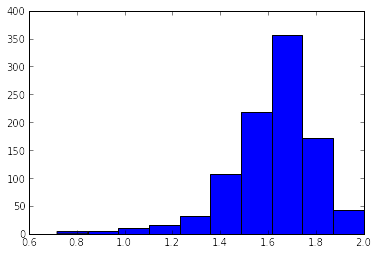

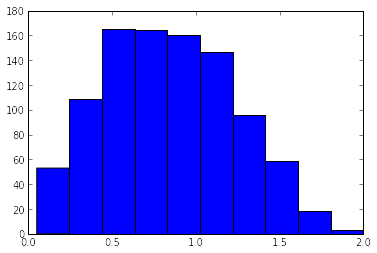

In [168]:
ModulationRatio(param_filter_query(data_store,sheet_name=['V1_Exc_L2/3','V1_Exc_L4'],st_contrast=[10]),ParameterSet({})).analyse()

In [76]:
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',st_contrast=100,st_orientation=0)
Analog_MeanSTDAndFanoFactor(dsv,ParameterSet({})).analyse()


  Starting Analog_MeanSTDAndFanoFactor analysis
  Starting Analog_MeanSTDAndFanoFactor analysis
/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/mozaik/analysis/analysis.py:1096: RuntimeWarning: invalid value encountered in double_scalars
  esyn_fano_factor = numpy.array([std**2/abs(mean) for (std,mean) in zip(esyn_std,esyn_mean)])
/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/mozaik/analysis/analysis.py:1097: RuntimeWarning: invalid value encountered in double_scalars
  isyn_fano_factor = numpy.array([std**2/abs(mean) for (std,mean) in zip(isyn_std,isyn_mean)])
Analog_MeanSTDAndFanoFactor analysis took: 49.3447329998seconds
Analog_MeanSTDAndFanoFactor analysis took: 49.3447329998seconds


[-66.834240020282067, -68.38671072720912, -66.317178650467554, -67.742933308780167, -65.210205992071124, -68.306766703354228, -62.373557359162447, -65.403599061704043, -67.952478712786203, -68.241085951507273, -62.262927532481896, -62.435691111571167, -64.219579171666609, -67.927208363371165, -66.671331260654995, -69.584018335419117, -65.786954869688245, -67.801040252861981, -66.675403691530249, -66.581131071594356, -64.913781369592044, -67.969361952640966, -62.818790093323138, -62.425360622108037, -62.428513681040457, -64.314423836083108, -66.371610974790357, -63.49850197333231, -67.314239876166226, -66.997899198905301]


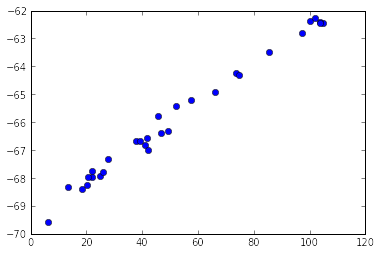

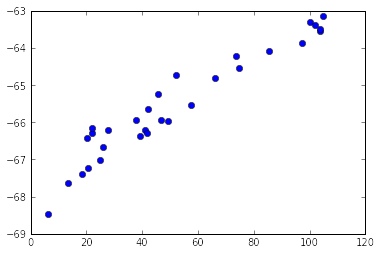

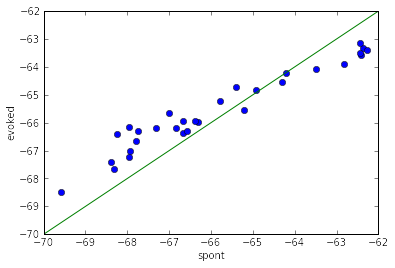

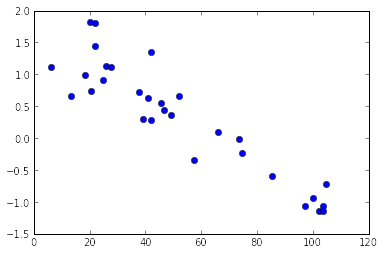

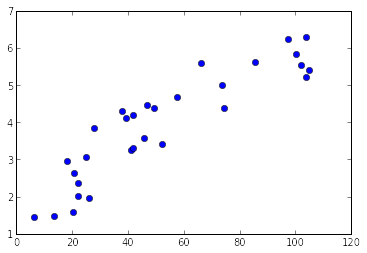

In [8]:
#sids = [38752, 34305, 22338, 33699, 37539, 21638, 36230, 38374, 16871, 17735, 18088, 29576, 33224, 38732, 22030, 23630, 36686, 23951, 39119, 23377, 17010, 19955, 39092, 19765, 32342, 28633, 33017, 21210, 29915, 17790, 26910, 37983]
sids = list(analog_center4)
a = param_filter_query(data_store,st_name=['InternalStimulus'],value_name='Mean(VM)',sheet_name='V1_Exc_L4').get_analysis_result()[0].get_value_by_id(sids)
b = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0,value_name='F0_Vm',sheet_name='V1_Exc_L4').get_analysis_result()[0].get_value_by_id(sids)
c = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0,value_name='-(x+y)(F0_Vm,Mean(VM))',sheet_name='V1_Exc_L4').get_analysis_result()[0].get_value_by_id(sids)
d = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0,value_name='F1_Vm',sheet_name='V1_Exc_L4').get_analysis_result()[0].get_value_by_id(sids)
e = data_store.full_datastore.get_analysis_result(identifier='PerNeuronValue',value_name = 'aff_samples', sheet_name = 'V1_Exc_L4')[0].get_value_by_id(sids)
pylab.figure()
pylab.plot(e,a,'o')
pylab.figure()
pylab.plot(e,-numpy.array(b),'o')
pylab.figure()
pylab.plot(a,-numpy.array(b),'o')
pylab.plot([-70,-62],[-70,-62])
pylab.xlabel('spont')
pylab.ylabel('evoked')
pylab.figure()
pylab.plot(e,c,'o')
pylab.figure()
pylab.plot(e,d,'o')

print a



In [59]:
print a[0]
print b[0]
print numpy.mean(a+b)

-68.0408720866
69.1102580943
0.269927230212


(0, 2000)

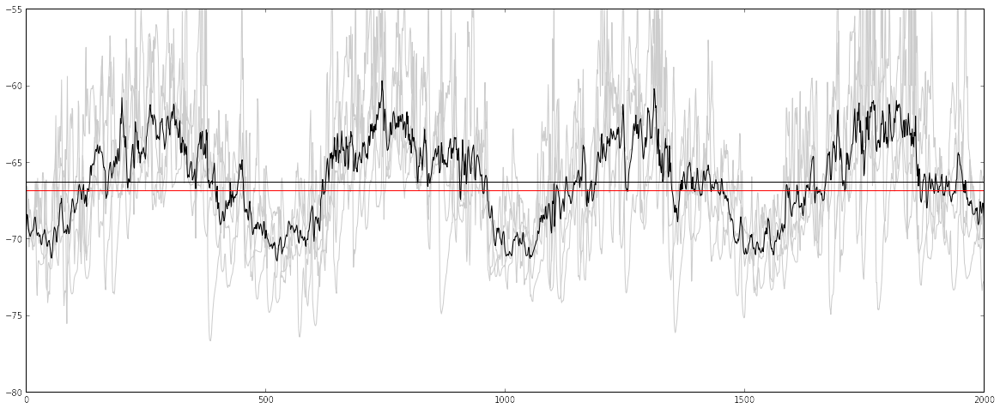

In [11]:
segs = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0,sheet_name='V1_Exc_L4').get_segments()

vm = [s.get_vm(sids[0]) for s in segs]

vm = numpy.array(vm)[:,250:]

spont = param_filter_query(data_store,st_name=['InternalStimulus'],sheet_name='V1_Exc_L4').get_segments()[0].get_vm(sids[0])


pylab.figure(figsize=(20,8))
pylab.plot(vm[0],c='0.8')
pylab.plot(vm[1],c='0.8')
pylab.plot(vm[2],c='0.8')
pylab.plot(vm[3],c='0.8')
pylab.plot(numpy.mean(vm,axis=0),c='0.0')
#pylab.plot(spont,'r')

pylab.plot([0,2000],[numpy.mean(vm),numpy.mean(vm)],'k')
pylab.plot([0,2000],[numpy.mean(spont),numpy.mean(spont)],'r')

pylab.ylim(-80,-55)
pylab.xlim([0,2000])

In [ ]:
pylab.figure()
pylab.plot(a,c,'o')
pylab.figure()
pylab.plot(b,c,'o')


In [6]:
print(analog_ids[2])
print a[2]
print b[2]
print c[2]
print d[2]
print e[2]

print a

22338
-61.1225027641
61.4763303468
-0.353827582652
5.85728404049
[ 102.10596943]
[-62.078378088456184, -66.516297224541532, -61.122502764122586, -62.350692467344466, -66.237729774454507, -65.410604036609641, -68.467236278298671, -61.974189681828229, -64.419861037875762, -62.048232623834345, -68.355658955997001, -65.787265748518692, -64.17023654915053, -67.383610778214361, -68.174690637278573, -66.933684226237517, -68.043235094566924, -65.097254940376502, -67.56814543084451, -69.846528378154261, -65.753766054449116, -63.418699810185061, -63.317037321160875, -67.917322813535137, -66.527050462502729, -66.431063243548579, -67.838599936687729, -64.671345807380348, -67.956223413541224, -66.685302498723189, -68.955677001296536, -61.825378619501933]


In [24]:
print e[19]

[ 6.25429014]


  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
OverviewPlot plotting took: 0.844115018845seconds
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_

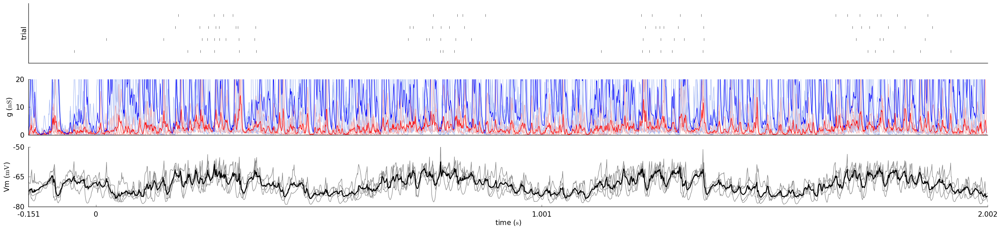

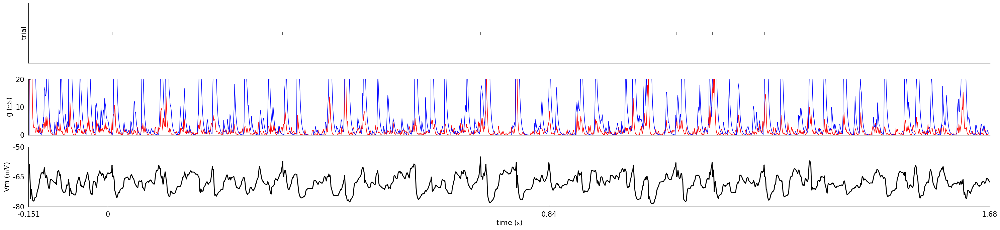

In [11]:
dsv = param_filter_query(data_store,st_name=['FullfieldDriftingSinusoidalGrating'],st_contrast=100,st_orientation=0)    
OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neuron' : sids[0] ,'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (30,7)},plot_file_name='Overview_ExcL4_1.png').plot({'Vm_plot.y_lim' : (-80,-50),'Conductance_plot.y_lim' : (0,20)})
dsv = param_filter_query(data_store,st_name=['InternalStimulus'])    
OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neuron' : sids[0] ,'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (30,7)},plot_file_name='Overview_ExcL4_1.png').plot({'Vm_plot.y_lim' : (-80,-50),'Conductance_plot.y_lim' : (0,20)})


0.930872583747
948
0.930872583747
948
0.930872583747


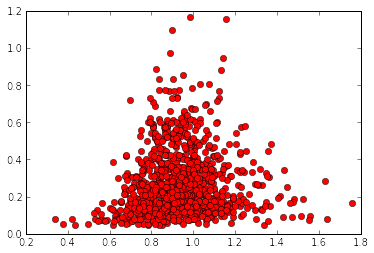

In [10]:
dsv1 = queries.param_filter_query(data_store,value_name='CV of ISI squared',st_name='InternalStimulus',sheet_name='V1_Exc_L4')
a= dsv1.get_analysis_result()[0].values
print numpy.mean(a)
ids = dsv1.get_analysis_result()[0].ids
dsv = queries.param_filter_query(data_store,value_name='Firing rate',st_name='InternalStimulus',sheet_name='V1_Exc_L4')
b=numpy.array(dsv.get_analysis_result()[0].get_value_by_id(ids))
print len(ids)
print numpy.mean(dsv1.get_analysis_result()[0].get_value_by_id(ids))
ids = numpy.array(ids)[b>0.0]
print len(ids)



print numpy.mean(dsv1.get_analysis_result()[0].get_value_by_id(ids))

pylab.plot(a,b,'ro')

In [26]:
ads = queries.param_filter_query(data_store,st_direct_stimulation_name="None",st_name='InternalStimulus',sheet_name='V1_Exc_L4',value_name='Correlation coefficient(psth (bin=10.0))',ads_unique=True).get_analysis_result()[0]
b = numpy.array(queries.param_filter_query(data_store,value_name='Firing rate',st_name='InternalStimulus',sheet_name='V1_Exc_L4').get_analysis_result()[0].get_value_by_id(ads.ids))

print numpy.shape(ads.values)
numpy.mean(ads.get_value_by_ids(ids,ids))



(961, 961)


IndexError: index 948 is out of bounds for axis 0 with size 948

In [27]:
ads = queries.param_filter_query(data_store,value_name='CV of ISI squared',st_name='InternalStimulus',sheet_name='V1_Exc_L4').get_analysis_result()[0]
b = numpy.array(queries.param_filter_query(data_store,value_name='Firing rate',st_name='InternalStimulus',sheet_name='V1_Exc_L4').get_analysis_result()[0].get_value_by_id(ads.ids))
numpy.mean(ads.get_value_by_id(numpy.array(ads.ids)[b>0.2]))

s = queries.param_filter_query(data_store,st_name='InternalStimulus',sheet_name='V1_Exc_L4').get_segments()[0]


0.94405615932212539

In [17]:
mean_and_std = lambda x : (numpy.mean(x),numpy.std(x))

s = queries.param_filter_query(data_store,st_name='InternalStimulus',sheet_name='V1_Exc_L4').get_segments()[0]
isis = [numpy.diff(st.magnitude) for st in s.spiketrains]
idxs = numpy.array([len(isi) for isi in isis])>20
mean_CV_L4E,std_CV_L4E = mean_and_std(numpy.array([numpy.std(isi)/numpy.mean(isi) for isi in isis])[idxs])
s = queries.param_filter_query(data_store,st_name='InternalStimulus',sheet_name='V1_Exc_L4',value_name='Correlation coefficient(psth (bin=10.0))',ads_unique=True).get_analysis_result()[0]
mean_CC_L4E,std_CC_L4E = mean_and_std(numpy.array(s.values)[idxs,:][:,idxs][numpy.triu_indices(sum(idxs==True),1)])

In [ ]:
s = queries.param_filter_query(data_store,st_name='InternalStimulus',sheet_name='V1_Exc_L4',value_name='Correlation coefficient(psth (bin=10.0))',ads_unique=True).get_analysis_result()[0]
idxs = numpy.array([len(isi) for isi in isis])>20

print numpy.mean(numpy.array(s.values)[idxs,:][:,idxs][numpy.triu_indices(sum(idxs==True),1)])

In [ ]:
PSTH(param_filter_query(data_store),ParameterSet({'bin_length' : 2.0 })).analyse()

  Starting PSTH analysis


In [ ]:
NeuronToNeuronAnalogSignalCorrelations(param_filter_query(data_store,analysis_algorithm='PSTH',value_name='psth (bin=10.0)'),ParameterSet({'convert_nan_to_zero' : True})).analyse()

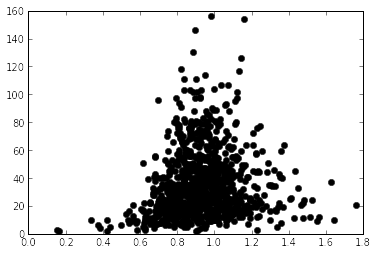

In [83]:
pylab.plot(cv_isi,[len(isi) for isi in isis],'ko')

In [69]:
print numpy.argmin([len(st.magnitude) for st in s.spiketrains])

11


In [70]:
print s.spiketrains[11]

[  2068.5   6688.1  95568.2] ms


In [73]:
print numpy.diff([  2068.5   ,6688.1,  95568.2])

[  4619.6  88880.1]


In [76]:
numpy.std([  4619.6,  88880.1])

42130.250000000007

In [38]:
numpy.var([10,20])

25.0

In [90]:
seg = queries.param_filter_query(data_store,st_name='InternalStimulus',sheet_name='V1_Exc_L2/3').get_segments()[0]

In [48]:
#sys.path.insert(0,'/home/antolikjan/projects/mozaik/mozaik/analysis')
from mozaik.analysis import analysis
from mozaik.storage import neo_neurotools_wrapper
reload(neo_neurotools_wrapper)
#print analysis.__file__
reload(analysis)
analysis.Irregularity(param_filter_query(data_store,st_direct_stimulation_name="None",st_name='InternalStimulus'),ParameterSet({})).analyse()

  Starting Irregularity analysis
Irregularity analysis took: 0.497019052505seconds


In [19]:
PopulationMeanAndVar(param_filter_query(data_store,analysis_algorithm='Irregularity',st_direct_stimulation_name="None",st_name='InternalStimulus'),ParameterSet({})).analyse()

  Starting PopulationMeanAndVar analysis
PopulationMeanAndVar analysis took: 4.68092989922seconds


In [18]:
param_filter_query(data_store,st_direct_stimulation_name="None",st_name='InternalStimulus',analysis_algorithm='PopulationMeanAndVar',identifier='SingleValue',value_name=['Mean(CV of ISI squared)','Var(CV of ISI squared)']).remove_ads_from_datastore()

In [143]:
seg.spiketrains[10].times.magnitude

array([   291.5,   6496.8,   9213.3,  12969.6])

In [ ]:
dsv = queries.param_filter_query(data_store,value_name=['F1_Vm'],st_name='FullfieldDriftingSinusoidalGrating')

In [24]:
print lsv1m_paper.__file__

/home/antolikjan/projects/mozaik/contrib/lsv1m_paper.pyc


  mean_firing_rate_L4E :0.253967221644
  mean_firing_rate_L4E :0.253967221644
  mean_firing_rate_L4E :0.253967221644
  mean_firing_rate_L4I :1.83576839827
  mean_firing_rate_L4I :1.83576839827
  mean_firing_rate_L4I :1.83576839827
  mean_firing_rate_L23E :0.14381355725
  mean_firing_rate_L23E :0.14381355725
  mean_firing_rate_L23E :0.14381355725
  mean_firing_rate_L23I :1.13287996546
  mean_firing_rate_L23I :1.13287996546
  mean_firing_rate_L23I :1.13287996546
  mean_CV_L4E :0.967038530653
  mean_CV_L4E :0.967038530653
  mean_CV_L4E :0.967038530653
  mean_CV_L4I :0.938790635432
  mean_CV_L4I :0.938790635432
  mean_CV_L4I :0.938790635432
  mean_CV_L23E :0.899920988888
  mean_CV_L23E :0.899920988888
  mean_CV_L23E :0.899920988888
  mean_CV_L23I :0.872568901778
  mean_CV_L23I :0.872568901778
  mean_CV_L23I :0.872568901778
  mean_CC_L4E :0.00511925984666
  mean_CC_L4E :0.00511925984666
  mean_CC_L4E :0.00511925984666
  mean_CC_L4I :0.0397441872469
  mean_CC_L4I :0.0397441872469
  mean_CC_L

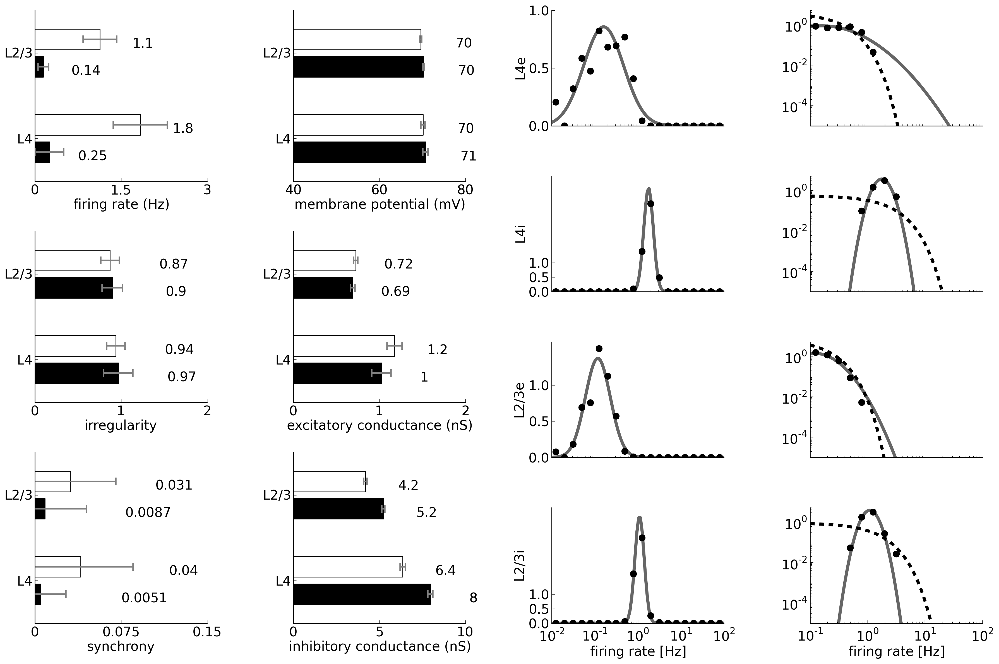

In [21]:
sys.path.insert(0,'/home/antolikjan/projects/mozaik/contrib')
import lsv1m_paper
reload(lsv1m_paper)
lsv1m_paper.SpontStatisticsOverview(data_store,ParameterSet({}),plot_file_name='SpontStatActOverview.png', fig_param={'dpi' : 200,'figsize': (18,12)}).plot()

  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'color': (0, 0, 0), 'linestyle': '-', 'label': 'contrast : 10'}
  {'color': (0, 0.45, 0.7), 'linestyle': '-', 'label': 'contrast : 100'}
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad

  {'color': (0, 0, 0), 'linestyle': '-', 'label': 'contrast : 10'}
  {'color': (0, 0.45, 0.7), 'linestyle': '-', 'label': 'contrast : 100'}
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'color': (0, 0, 0), 'linestyle': '-', 'label': 'contrast : 10'}
  {'color': (0, 0.45, 0.7), 'linestyle': '-', 'label': 'contrast : 100'}
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_l

  {'color': (0, 0, 0), 'linestyle': '-', 'label': 'contrast : 10'}
  {'color': (0, 0.45, 0.7), 'linestyle': '-', 'label': 'contrast : 100'}
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'color': (0, 0, 0), 'linestyle': '-', 'label': 'contrast : 10'}
  {'color': (0, 0.45, 0.7), 'linestyle': '-', 'label': 'contrast : 100'}
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_l

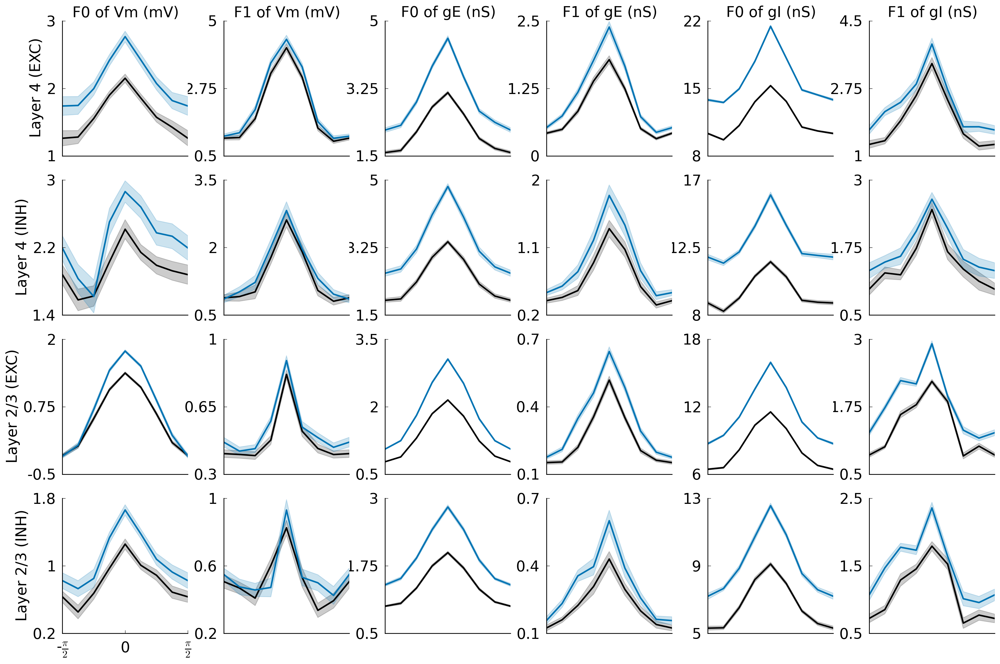

In [59]:
reload(lsv1m_paper)
lsv1m_paper.OrientationTuningSummaryAnalogSignals(data_store,ParameterSet({'exc_sheet_name1': 'V1_Exc_L4','inh_sheet_name1': 'V1_Inh_L4','exc_sheet_name2': 'V1_Exc_L2/3','inh_sheet_name2': 'V1_Inh_L2/3'}),fig_param={'dpi' : 200,'figsize': (18,12)},plot_file_name='OrientationTuningSummaryAnalogSignals.png').plot({'*.fontsize' : 19})            

  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, '

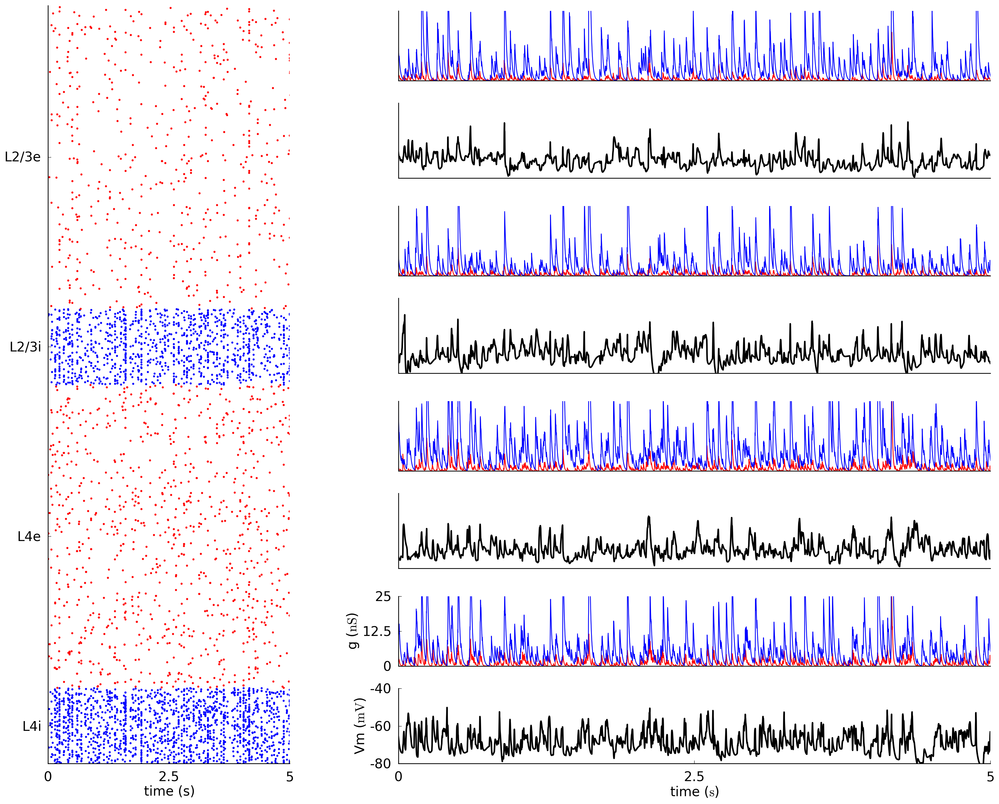

In [19]:
reload(lsv1m_paper)
lsv1m_paper.SpontActOverview(data_store,ParameterSet({'l4_exc_neuron' : analog_ids[0], 'l4_inh_neuron' : analog_ids_inh[0],'l23_exc_neuron' : analog_ids23[0],'l23_inh_neuron' : analog_ids_inh23[0]}),plot_file_name='SpontActOverview.png', fig_param={'dpi' : 200,'figsize': (18,14.5)}).plot()

ActivityMovie plotting took: 5.03408002853seconds


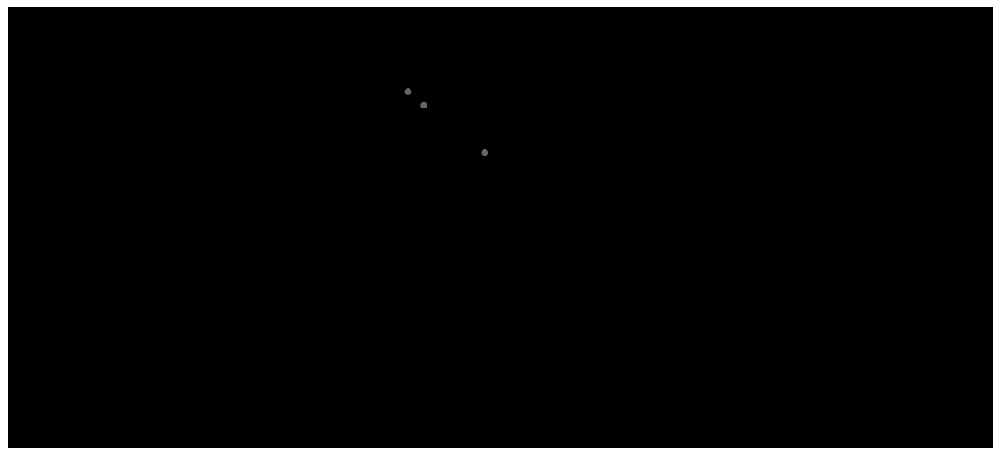

In [51]:
reload(mozaik.visualization.plotting)
dsv = param_filter_query(data_store,st_name=['InternalStimulus'])    
mozaik.visualization.plotting.ActivityMovie(dsv,ParameterSet({'bin_width': 10.0,'scatter':  True,'resolution': 10,'sheet_name': 'V1_Exc_L2/3'}),fig_param={'dpi' : 100,'figsize': (13,6)},plot_file_name='stc4').plot()


In [ ]:
import mozaik.visualization.plotting

In [ ]:
dsv = param_filter_query(data_store,st_name=['InternalStimulus'],st_direct_stimulation_name="None")    
RasterPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neurons' : spike_ids,'trial_averaged_histogram': False, 'spontaneous' : False}),fig_param={'dpi' : 100,'figsize': (28,12)},plot_file_name='SSExcRasterL4.png').plot({'SpikeRasterPlot.group_trials':True})



In [ ]:
dsv = param_filter_query(data_store,st_name='DriftingSinusoidalGratingDisk',analysis_algorithm=['TrialAveragedFiringRate'])    
PlotTuningCurve(dsv,ParameterSet({'parameter_name' : 'radius', 'neurons': list(center4), 'sheet_name' : 'V1_Exc_L4','centered'  : False,'mean' : False, 'polar' : False, 'pool'  : False}),plot_file_name='SizeTuningExcL4.png',fig_param={'dpi' : 100,'figsize': (32,7)}).plot()
PlotTuningCurve(dsv,ParameterSet({'parameter_name' : 'radius', 'neurons': list(center23), 'sheet_name' : 'V1_Exc_L2/3','centered'  : False,'mean' : False, 'polar' : False, 'pool'  : False}),plot_file_name='SizeTuningExcL23.png',fig_param={'dpi' : 100,'figsize': (32,7)}).plot()        
    
if False:
        dsv = param_filter_query(data_store,st_name=['DriftingSinusoidalGratingDisk'],st_contrast=100)    
        OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neuron' : numpy.array(list(analog_center4))[0], 'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (28,12)},plot_file_name='Overview_ExcL4_1.png').plot()
        OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neuron' : numpy.array(list(analog_center4))[1], 'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (28,12)},plot_file_name='Overview_ExcL4_2.png').plot()
        OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L4', 'neuron' : numpy.array(list(analog_center4))[2], 'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (28,12)},plot_file_name='Overview_ExcL4_3.png').plot()
    
        OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L2/3', 'neuron' : numpy.array(list(analog_center23))[0], 'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (28,12)},plot_file_name='Overview_ExcL23_1.png').plot()
        OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L2/3', 'neuron' : numpy.array(list(analog_center23))[1], 'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (28,12)},plot_file_name='Overview_ExcL23_2.png').plot()
        OverviewPlot(dsv,ParameterSet({'sheet_name' : 'V1_Exc_L2/3', 'neuron' : numpy.array(list(analog_center23))[2], 'sheet_activity' : {}, 'spontaneous' : True}),fig_param={'dpi' : 100,'figsize': (28,12)},plot_file_name='Overview_ExcL23_3.png').plot()




In [ ]:
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F0_Exc_Cond-Mean(ECond)',sheet_name='V1_Exc_L4')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F0_Inh_Cond-Mean(ICond)',sheet_name='V1_Exc_L4')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F1_Exc_Cond',sheet_name='V1_Exc_L4')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F1_Inh_Cond',sheet_name='V1_Exc_L4')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()

dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F0_Exc_Cond-Mean(ECond)',sheet_name='V1_Exc_L2/3')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F0_Inh_Cond-Mean(ICond)',sheet_name='V1_Exc_L2/3')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F1_Exc_Cond',sheet_name='V1_Exc_L2/3')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name='F1_Inh_Cond',sheet_name='V1_Exc_L2/3')    
GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
        

In [ ]:
#queries.param_filter_query(data_store,analysis_algorithm="GaussianTuningCurveFit",sheet_name=["V1_Exc_L2/3"],st_contrast=100).print_content(full_ADS=True)

#dsv = queries.param_filter_query(data_store,value_name=['orientation preference of F1_Exc_Cond','orientation preference of Firing rate'],sheet_name=["V1_Exc_L4"],st_contrast=100)

or_pref_F1_Exc_L4 = queries.param_filter_query(data_store,value_name=['orientation preference of F1_Exc_Cond'],sheet_name=["V1_Exc_L4"],st_contrast=100,ads_unique=True).get_analysis_result()[0]
or_pref_F1_Inh_L4 = queries.param_filter_query(data_store,value_name=['orientation preference of F1_Inh_Cond'],sheet_name=["V1_Exc_L4"],st_contrast=100,ads_unique=True).get_analysis_result()[0]
or_pref_F0_Exc_L4 = queries.param_filter_query(data_store,value_name=['orientation preference of F0_Exc_Cond-Mean(ECond)'],sheet_name=["V1_Exc_L4"],st_contrast=100,ads_unique=True).get_analysis_result()[0]
or_pref_F0_Inh_L4 = queries.param_filter_query(data_store,value_name=['orientation preference of F0_Inh_Cond-Mean(ICond)'],sheet_name=["V1_Exc_L4"],st_contrast=100,ads_unique=True).get_analysis_result()[0]

or_pref_F1_Exc_L23 = queries.param_filter_query(data_store,value_name=['orientation preference of F1_Exc_Cond'],sheet_name=["V1_Exc_L2/3"],st_contrast=100,ads_unique=True).get_analysis_result()[0]
or_pref_F1_Inh_L23 = queries.param_filter_query(data_store,value_name=['orientation preference of F1_Inh_Cond'],sheet_name=["V1_Exc_L2/3"],st_contrast=100,ads_unique=True).get_analysis_result()[0]
or_pref_F0_Exc_L23 = queries.param_filter_query(data_store,value_name=['orientation preference of F0_Exc_Cond-Mean(ECond)'],sheet_name=["V1_Exc_L2/3"],st_contrast=100,ads_unique=True).get_analysis_result()[0]
or_pref_F0_Inh_L23 = queries.param_filter_query(data_store,value_name=['orientation preference of F0_Inh_Cond-Mean(ICond)'],sheet_name=["V1_Exc_L2/3"],st_contrast=100,ads_unique=True).get_analysis_result()[0]

or_pref_L4 = queries.param_filter_query(data_store,value_name=['orientation preference of Firing rate'],sheet_name=["V1_Exc_L4"],st_contrast=100,ads_unique=True).get_analysis_result()[0]
or_pref_L23 = queries.param_filter_query(data_store,value_name=['orientation preference of Firing rate'],sheet_name=["V1_Exc_L2/3"],st_contrast=100,ads_unique=True).get_analysis_result()[0]




In [ ]:
l4_ids = or_pref_F1_Exc_L4.ids
l23_ids = or_pref_F1_Exc_L23.ids

from mozaik.tools.circ_stat import circular_dist

or_pref_F1_Exc_L4 = circular_dist(numpy.array(or_pref_F1_Exc_L4.get_value_by_id(l4_ids)),numpy.array(or_pref_L4.get_value_by_id(l4_ids)),numpy.pi)
or_pref_F1_Inh_L4 = circular_dist(numpy.array(or_pref_F1_Inh_L4.get_value_by_id(l4_ids)),numpy.array(or_pref_L4.get_value_by_id(l4_ids)),numpy.pi)
or_pref_F0_Exc_L4 = circular_dist(numpy.array(or_pref_F0_Exc_L4.get_value_by_id(l4_ids)),numpy.array(or_pref_L4.get_value_by_id(l4_ids)),numpy.pi)
or_pref_F0_Inh_L4 = circular_dist(numpy.array(or_pref_F0_Inh_L4.get_value_by_id(l4_ids)),numpy.array(or_pref_L4.get_value_by_id(l4_ids)),numpy.pi)

or_pref_F1_Exc_L23 = circular_dist(numpy.array(or_pref_F1_Exc_L23.get_value_by_id(l23_ids)),numpy.array(or_pref_L23.get_value_by_id(l23_ids)),numpy.pi)
or_pref_F1_Inh_L23 = circular_dist(numpy.array(or_pref_F1_Inh_L23.get_value_by_id(l23_ids)),numpy.array(or_pref_L23.get_value_by_id(l23_ids)),numpy.pi)
or_pref_F0_Exc_L23 = circular_dist(numpy.array(or_pref_F0_Exc_L23.get_value_by_id(l23_ids)),numpy.array(or_pref_L23.get_value_by_id(l23_ids)),numpy.pi)
or_pref_F0_Inh_L23 = circular_dist(numpy.array(or_pref_F0_Inh_L23.get_value_by_id(l23_ids)),numpy.array(or_pref_L23.get_value_by_id(l23_ids)),numpy.pi)



In [ ]:
pylab.figure()
pylab.plot(or_pref_F1_Exc_L4,or_pref_F1_Inh_L4,'o')
pylab.xlim(0,numpy.pi/2)
pylab.ylim(0,numpy.pi/2)

pylab.figure()
pylab.plot(or_pref_F0_Exc_L4,or_pref_F0_Inh_L4,'o')
pylab.xlim(0,numpy.pi/2)
pylab.ylim(0,numpy.pi/2)

pylab.figure()
pylab.plot(or_pref_F1_Exc_L23,or_pref_F1_Inh_L23,'o')
pylab.xlim(0,numpy.pi/2)
pylab.ylim(0,numpy.pi/2)

pylab.figure()
pylab.plot(or_pref_F0_Exc_L23,or_pref_F0_Inh_L23,'o')
pylab.xlim(0,numpy.pi/2)
pylab.ylim(0,numpy.pi/2)

In [ ]:
print len(center4)
print len(center23)
dsv = param_filter_query(data_store,st_name='DriftingSinusoidalGratingDisk',sheet_name=['V1_Exc_L4','V1_Exc_L2/3'],analysis_algorithm='TrialAveragedFiringRate')    
SizeTuningAnalysis(dsv,ParameterSet({'neurons' : center4.tolist(), 'sheet_name' : 'V1_Exc_L4'})).analyse()
SizeTuningAnalysis(dsv,ParameterSet({'neurons' : center23.tolist(), 'sheet_name' : 'V1_Exc_L2/3'})).analyse()
dsv = param_filter_query(data_store,value_name=['Suppression index of Firing rate'],sheet_name='V1_Exc_L4')   
print dsv.get_analysis_result()[0].values
print dsv.get_analysis_result()[1].values        


In [ ]:
len(center4)
len(center23)

In [ ]:
dsv = param_filter_query(data_store,value_name=['Max. facilitation radius of Firing rate'])   
PerNeuronValuePlot(dsv,ParameterSet({"cortical_view" : False}),fig_param={'dpi' : 100,'figsize': (6,12)}).plot({'*.x_lim' : (0,3)})

#dsv = param_filter_query(data_store,value_name=['Max. facilitation radius of Firing rate'],st_contrast=5)   
#PerNeuronValuePlot(dsv,ParameterSet({"cortical_view" : False}),fig_param={'dpi' : 100,'figsize': (6,12)}).plot({'*.x_lim' : (0,3)})


In [57]:
asl = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',y_axis_name='psth (bin=10.0) trial-to-trial mean',sheet_name=['V1_Exc_L4']).get_analysis_result()[0]



200
0.9 sp/s


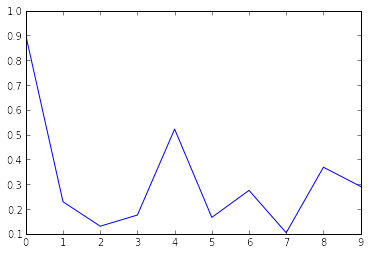

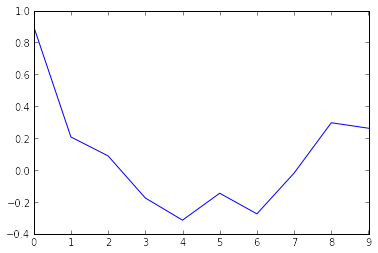

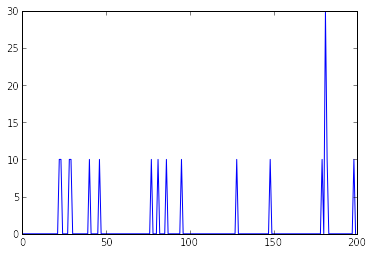

In [70]:
print len(asl.get_asl_by_id(spike_ids[0]))
import numpy.fft
pylab.plot(numpy.abs(numpy.fft.fft(asl.get_asl_by_id(spike_ids[0])))[:10]/200)
pylab.figure()
pylab.plot(numpy.fft.rfft(asl.get_asl_by_id(spike_ids[0]))[:10]/200)
pylab.figure()
pylab.plot(asl.get_asl_by_id(spike_ids[0]))
print numpy.mean(asl.get_asl_by_id(spike_ids[0]))

In [37]:
asl = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name=['F1(psth (bin=10.0) trial-to-trial mean)'],analysis_algorithm='Analog_F0andF1',sheet_name=['V1_Exc_L4']).get_analysis_result()[0]
pylab.hist(asl.get_value_by_id(spike_ids))


IndexError: list index out of range

In [ ]:
sys.path.insert(0,'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/mozaik/analysis')
import vision
reload(vision)

print vision.__file__

dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',y_axis_name='psth (bin=10.0) trial-to-trial mean',sheet_name=['V1_Exc_L4','V1_Exc_L2/3','V1_Inh_L4','V1_Inh_L2/3'])   
vision.Analog_F0andF1(dsv,ParameterSet({})).analyse()



/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/mozaik/analysis/vision.pyc


  Starting Analog_F0andF1 analysis
Analog_F0andF1 analysis took: 79.1947259903seconds


In [40]:
dsv = queries.param_filter_query(data_store,value_name=['orientation CV(F1(psth (bin=10.0) trial-to-trial mean))'],sheet_name='V1_Exc_L4',st_contrast=[100]).print_content()   

  DSV info:
     Number of recordings: 0
     Number of ADS: 0


/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/mozaik/analysis/analysis.pyc


  Starting GaussianTuningCurveFit analysis
/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/scipy/optimize/minpack.py:402: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
GaussianTuningCurveFit analysis took: 171.522695065seconds
  Starting CircularVarianceOfTuningCurve analysis
CircularVarianceOfTuningCurve analysis took: 4.57974100113seconds
  Starting GaussianTuningCurveFit analysis
GaussianTuningCurveFit analysis took: 197.244219065seconds
  Starting CircularVarianceOfTuningCurve analysis
CircularVarianceOfTuningCurve analysis took: 4.58084893227seconds


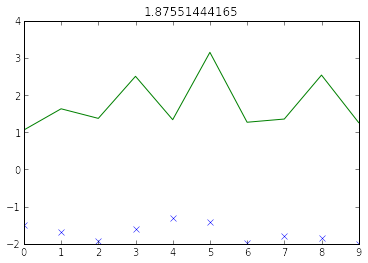

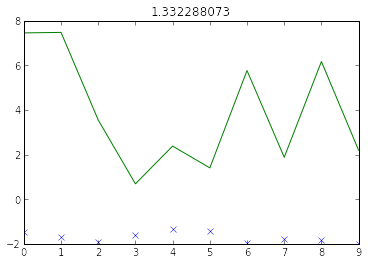

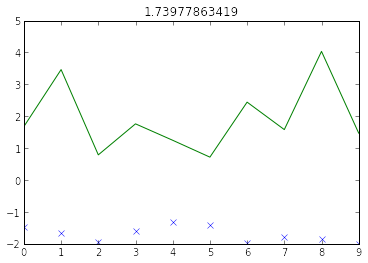

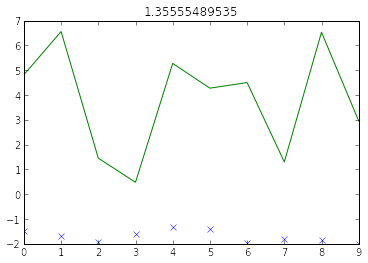

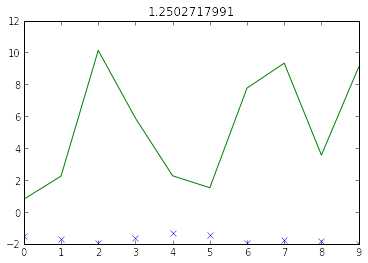

...

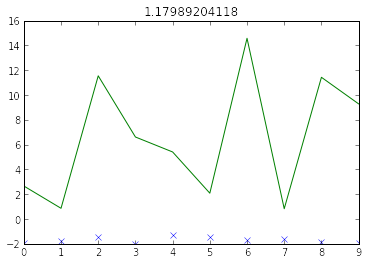

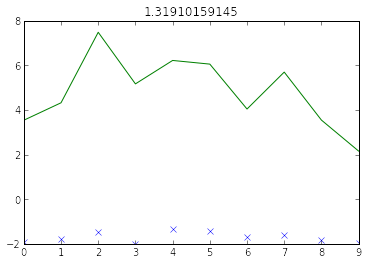

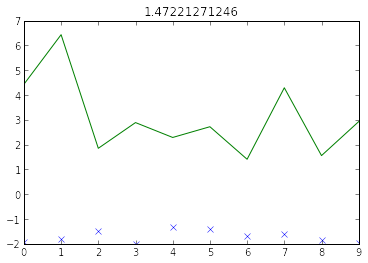

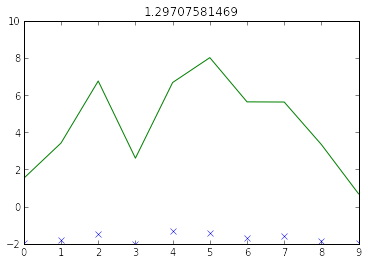

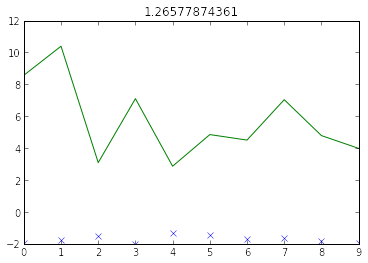

In [ ]:
sys.path.insert(0,'/home/antolikjan/remote/cluster_UNIC/dev/pkg/mozaik/mozaik/mozaik/analysis')
import analysis
reload(analysis)

print analysis.__file__

dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name=['F1(psth (bin=10.0) trial-to-trial mean)'],analysis_algorithm='Analog_F0andF1',sheet_name=['V1_Exc_L4','V1_Exc_L2/3','V1_Inh_L4','V1_Inh_L2/3'])    
analysis.GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
analysis.CircularVarianceOfTuningCurve(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
dsv = param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',value_name=['F0(psth (bin=10.0) trial-to-trial mean)'],analysis_algorithm='Analog_F0andF1',sheet_name=['V1_Exc_L4','V1_Exc_L2/3','V1_Inh_L4','V1_Inh_L2/3'])    
analysis.GaussianTuningCurveFit(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()
analysis.CircularVarianceOfTuningCurve(dsv,ParameterSet({'parameter_name' : 'orientation'})).analyse()




In [57]:
dsv = queries.param_filter_query(data_store,st_name='FullfieldDriftingSinusoidalGrating',analysis_algorithm='Analog_F0andF1')
TrialMean(dsv,ParameterSet({'cond_exc' : False, 'vm' : False, 'cond_inh' : False})).analyse()

  Starting TrialMean analysis
TrialMean analysis took: 9.83408904076seconds


L4Exc Mean HWHH: 36.6992548305


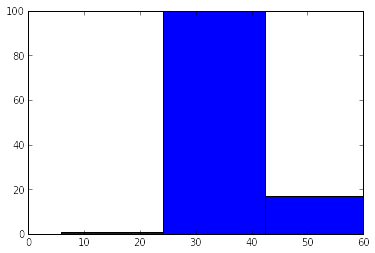

In [6]:
dsv = queries.param_filter_query(data_store,value_name=['orientation HWHH of Firing rate'],sheet_name=['V1_Exc_L4'],st_contrast=[10])    
a = numpy.array(dsv.get_analysis_result()[0].get_value_by_id(spike_ids))
pylab.hist(a)
pylab.xlim(0,60)|
print "L4Exc Mean HWHH:", numpy.mean(a[a>0])

L4Exc Mean HWHH: 26.336975588


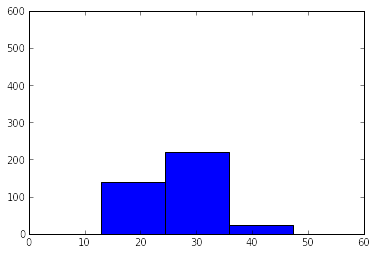

In [10]:
dsv = queries.param_filter_query(data_store,value_name=['orientation HWHH of F1(psth (bin=10.0) trial-to-trial mean)'],sheet_name=['V1_Exc_L4'],st_contrast=[10])    
a = numpy.array(dsv.get_analysis_result()[0].get_value_by_id(spike_ids))
pylab.hist(a)
pylab.xlim(0,60)
print "L4Exc Mean HWHH:", numpy.mean(a[a>0])

In [36]:
dsv = queries.param_filter_query(data_store,value_name=['F1(psth (bin=10.0) trial-to-trial mean)'],st_name='FullfieldDriftingSinusoidalGrating',analysis_algorithm='Analog_F0andF1')
PlotTuningCurve(dsv, ParameterSet({'parameter_name' : 'orientation', 'neurons': list(analog_ids_inh), 'sheet_name' : 'V1_Inh_L4','centered'  : True,'mean' : True,'pool' : False,'polar' : False})).plot()

ValueError: max() arg is an empty sequence

  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'color': (0, 0, 0), 'linestyle': '-', 'label': 'contrast : 10'}
  {'color': (0, 0.45, 0.7), 'linestyle': '-', 'label': 'contrast : 100'}
PlotTuningCurve plotting took: 0.0742449760437seconds


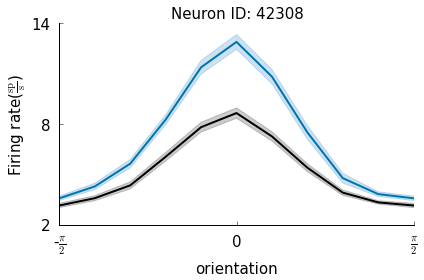

In [9]:
dsv = queries.param_filter_query(data_store,value_name=['Firing rate'],st_name='FullfieldDriftingSinusoidalGrating')
PlotTuningCurve(dsv, ParameterSet({'parameter_name' : 'orientation', 'neurons': list(analog_ids_inh), 'sheet_name' : 'V1_Inh_L4','centered'  : True,'mean' : True,'pool' : False,'polar' : False})).plot()

In [6]:
param_filter_query(data_store,analysis_algorithm="PopulationMeanAndVar",identifier='SingleValue',sheet_name='V1_Exc_L4').print_content(full_ADS=True)

  DSV info:
     Number of recordings: 0
     Number of ADS: 4
       SingleValue : 4
  ANALYSIS RESULTS
  {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'SingleValue', "name":'SingleValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":134400, "frame_duration":134400, "name":\'InternalStimulus\', "trial":None}', "value":1.9753720647802346, "value_name":'Var(Firing rate)'}
  {"module_path" :"mozaik.analysis.data_structures","analysis_algorithm":'PopulationMeanAndVar', "identifier":'SingleValue', "name":'SingleValue', "neuron":None, "period":None, "sheet_name":'V1_Exc_L4', "stimulus_id":'{"module_path" :"mozaik.stimuli","direct_stimulation_name":\'None\', "duration":134400, "frame_duration":134400, "name":\'InternalStimulus\', "trial":0}', "value":0.040418438754382099, "value_name":'Var(CV of ISI squared)'}
  {"module_path"

In [13]:
param_filter_query(data_store,analysis_algorithm="NeuronToNeuronAnalogSignalCorrelations").print_content(full_ADS=True)

  DSV info:
     Number of recordings: 2532
       InternalStimulus : 12
       NaturalImageWithEyeMovement : 120
       FullfieldDriftingSinusoidalGrating : 2400
     Number of ADS: 0
  ANALYSIS RESULTS


In [22]:
dsv = param_filter_query(data_store,sheet_name='V1_Exc_L4',analysis_algorithm='PSTH',identifier='AnalogSignalList')

In [24]:
NeuronToNeuronAnalogSignalCorrelations(param_filter_query(data_store,sheet_name='V1_Exc_L4',analysis_algorithm='PSTH'),ParameterSet({'convert_nan_to_zero' : True})).analyse()

  Starting NeuronToNeuronAnalogSignalCorrelations analysis
/home/antolikjan/virt_env/oldmozaik/local/lib/python2.7/site-packages/numpy/lib/function_base.py:2124: RuntimeWarning: invalid value encountered in divide
  return c/sqrt(multiply.outer(d,d))
NeuronToNeuronAnalogSignalCorrelations analysis took: 66.8985431194seconds


[0.93, 1.19]
[1.0526436871033593, 1.2969475931415737]
[0.85309130284922219, 1.0390912212989996]


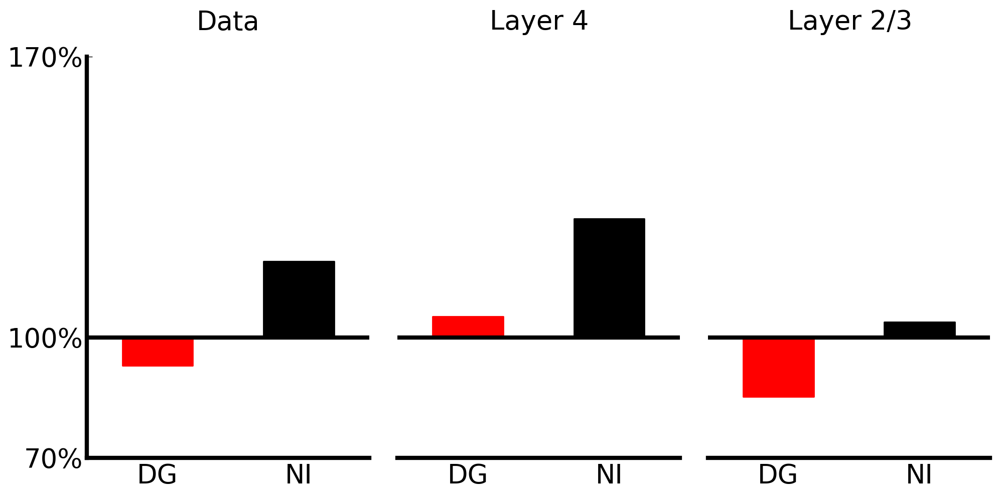

In [61]:
reload(lsv1m_paper)
lsv1m_paper.TrialToTrialVariabilityComparison(data_store,ParameterSet({'sheet_name1' : 'V1_Exc_L4','sheet_name2' : 'V1_Exc_L2/3','data_dg' : 0.93 , 'data_ni' : 1.19}),fig_param={'dpi' : 200,'figsize': (10,5)},plot_file_name='TrialToTrialVariabilityComparison.png').plot()

[0.93, 1.19]
[0.97956738683615607, 1.2969475931415737]
[0.9200971584371006, 1.0390912212989993]


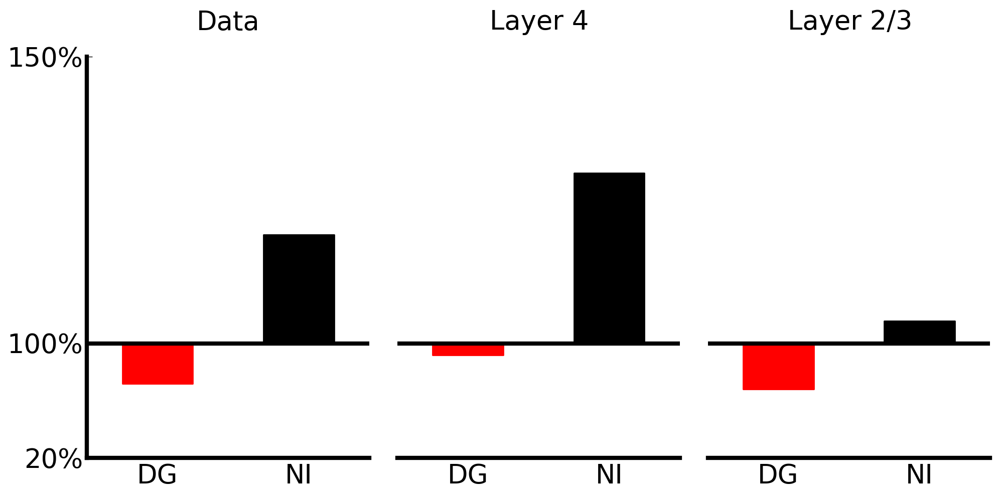

In [155]:
reload(lsv1m_paper)
lsv1m_paper.TrialToTrialVariabilityComparisonNew(data_store,ParameterSet({'sheet_name1' : 'V1_Exc_L4','sheet_name2' : 'V1_Exc_L2/3','data_dg' : 0.93 , 'data_ni' : 1.19}),fig_param={'dpi' : 200,'figsize': (10,5)},plot_file_name='TrialToTrialVariabilityComparison.png').plot()

  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, '

51
51
GR_SP_L4:  0.0425050280663 58.6164556367
NI_SP_L4:  0.167816705023 0.600393566984
GR_SP_L23:  0.00576425715741 53.0436583445
NI_SP_L23:  0.0216301269618 5.80742196803
GR_VM_L4:  0.376251016738 98.4278733342
NI_VM_L4:  0.340493828208 11.6053312869
GR_VM_L23:  0.0158273475525 50.3552123809
NI_VM_L23:  0.131464558333 9.41602797038
(51,)
(51,)


TrialCrossCorrelationAnalysis plotting took: 20.978728056seconds


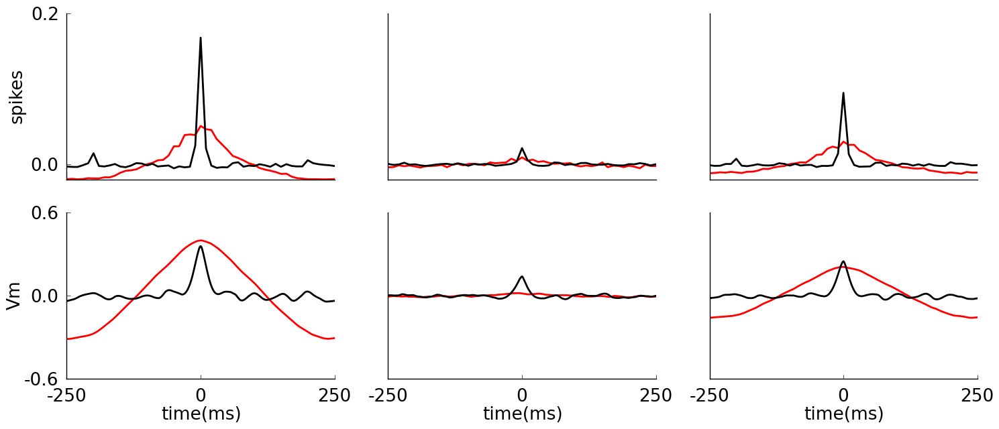

In [152]:
reload(lsv1m_paper)
lsv1m_paper.TrialCrossCorrelationAnalysis(data_store,ParameterSet({'neurons1' : list(analog_ids),'sheet_name1' : 'V1_Exc_L4','neurons2' : list(analog_ids23),'sheet_name2' : 'V1_Exc_L2/3', 'window_length' : 250}),fig_param={"dpi" : 100,"figsize": (15,6.5)},plot_file_name="trial-to-trial-cross-correlation.png").plot({'*.Vm.title' : None, '*.fontsize' : 19})

  {'linestyles': None, 'y_label': None, 'labels': None, 'y_tick_labels': None, 'colors': None, 'y_lim': None, 'linewidth': 1, 'x_scale': 'linear', 'fill': False, 'y_ticks': None, 'title': None, 'x_label': None, 'x_axis': True, 'y_label_pad': None, 'x_label_pad': None, 'bottom_border': True, 'y_tick_style': 'Min', 'left_border': True, 'top_right_border': False, 'grid': False, 'fontsize': 15, 'x_tick_labels': None, 'legend': False, 'x_scale_base': None, 'y_tick_pad': 10, 'y_scale': 'linear', 'x_tick_style': 'Min', 'x_ticks': None, 'x_tick_pad': 10, 'y_scale_base': None, 'y_axis': True, 'x_lim': None, 'mean': False}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color': '#848484', 'linestyle': '-'}
  {'color'

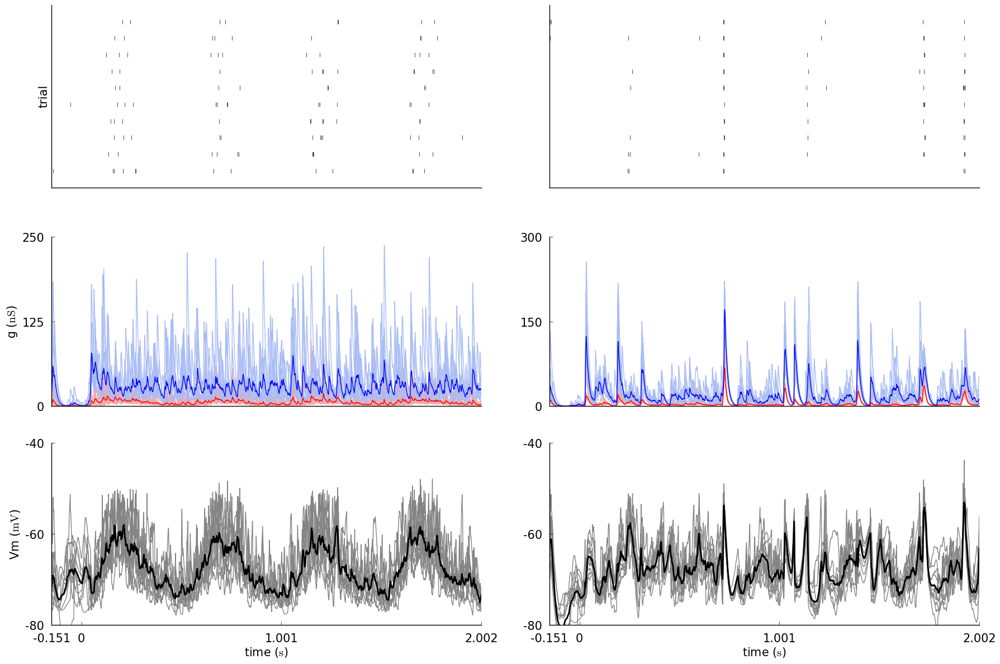

In [138]:
#10 , 15
lsv1m_paper.StimulusResponseComparison(data_store,ParameterSet({'neuron' : analog_ids[21],'sheet_name' : 'V1_Exc_L4'}),fig_param={'dpi' : 100,'figsize': (18,12)},plot_file_name='StimulusResponseComparison1L23.png').plot()